# Step 0: Import Packages

In [1]:
import math
import random
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Reshape, Flatten, Dropout, Conv2D, Conv2DTranspose
from tensorflow.keras.layers import BatchNormalization, LeakyReLU
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tqdm import tqdm

# Step 1: Load dataset

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"parzival0116","key":"2d3d48e72242e58608c5c21d056a5638"}'}

In [ ]:
!ls -al

total 16
drwxr-xr-x 1 root root 4096 Apr 21 13:39 .
drwxr-xr-x 1 root root 4096 Apr 29 05:09 ..
drwxr-xr-x 4 root root 4096 Apr 21 13:38 .config
drwxr-xr-x 1 root root 4096 Apr 21 13:39 sample_data


In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!ls ~/.kaggle/

ls: cannot access '/root/.kaggle/': No such file or directory


In [ ]:
# You can check if everything's okay by running this command.
! kaggle datasets list

ref                                                         title                                              size  lastUpdated          downloadCount  
----------------------------------------------------------  ------------------------------------------------  -----  -------------------  -------------  
gpreda/reddit-vaccine-myths                                 Reddit Vaccine Myths                              227KB  2021-04-28 17:13:57           3824  
crowww/a-large-scale-fish-dataset                           A Large Scale Fish Dataset                          3GB  2021-04-28 17:03:01           2222  
promptcloud/careerbuilder-job-listing-2020                  Careerbuilder Job Listing 2020                     42MB  2021-03-05 06:59:52            479  
dhruvildave/wikibooks-dataset                               Wikibooks Dataset                                   1GB  2021-02-18 10:08:27           1410  
mathurinache/twitter-edge-nodes                             Twitter Edge Nod

In [ ]:
# Download and unzip sign-language-mnist dataset into '/usr/local'
! kaggle datasets download -d splcher/animefacedataset --path '/usr/local' --unzip

 94% 372M/395M [00:03<00:00, 91.9MB/s]
100% 395M/395M [00:03<00:00, 110MB/s] 


In [ ]:
!ls /usr/local/dataset

images


In [ ]:
!mkdir /usr/local/dataset
!mv /usr/local/images /usr/local/dataset

In [ ]:
def plot_images(images):
  plt.figure(figsize=(10, 10))

  for i in range(images.shape[0]):
    plt.subplot(4,4,i+1)
    image=images[i,:,:,:]
    image=(image+1)/2.0
    plt.imshow(image)
    plt.axis('off')

  plt.tight_layout()
  plt.show()

Found 63565 files belonging to 1 classes.


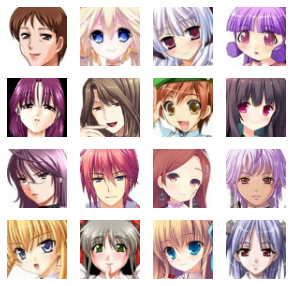

In [ ]:
# images dataset path
path = '/usr/local/dataset'

# Set random seed for reproducibility
seed = 7452
random.seed(seed)

# Batch size during training
batch_size = 128

# Create dataset
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    path,
    image_size = (64, 64),
    validation_split=None,
    seed=seed,
    subset=None
)

# dataset for performance
AUTOTUNE = tf.data.AUTOTUNE
dataset = dataset.cache().prefetch(buffer_size=AUTOTUNE)

# Show images
plt.figure(figsize=(5, 5))
for image, labels in dataset.take(1):
    for i in range(16):
        ax = plt.subplot(4, 4, i + 1)
        plt.imshow(image[i].numpy().astype("uint8"))
        plt.axis("off")

# Step 1-2: Dataset Normalization

In [ ]:
# Rescale RGB [0, 255] to [0, 1]
normalization_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
normalized_ds = dataset.map(lambda x, y: (normalization_layer(x), y))

In [ ]:
trainset = []
d_len = 0
for image_batch, label_batch in normalized_ds:
    for image in image_batch:
      d_len = len(trainset)
      if(d_len >= 15000):
        break
      else:
        trainset.append(image)
    if(d_len == 15000):
      break

In [ ]:
in_shape = trainset[1].shape
trainset = np.array(trainset)

# Step 2: Define generator

In [ ]:
from tensorflow.keras.layers import Dense, Reshape, Flatten, Dropout, Conv2D, Conv2DTranspose
from tensorflow.keras.layers import BatchNormalization, LeakyReLU
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam

# Define generator
G = Sequential()

# foundation for 4x4 image
G.add(Dense(256 * 4 * 4, input_dim=100))
G.add(LeakyReLU(alpha=0.2))
G.add(Reshape((4, 4, 256)))

# upsample to 8x8
G.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
G.add(LeakyReLU(alpha=0.2))

# upsample to 16x16
G.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
G.add(LeakyReLU(alpha=0.2))

# upsample to 32x32
G.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
G.add(LeakyReLU(alpha=0.2))

# upsample to 64x64
G.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
G.add(LeakyReLU(alpha=0.2))

# output layer
G.add(Conv2D(3, (3,3), activation='tanh', padding='same'))

G.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 4096)              413696    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 4096)              0         
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 128)         524416    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 16, 16, 128)       262272    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0

# Step 3: Define discriminator

In [ ]:
# Define discriminator
D = Sequential()

# normal 64*64
D.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
D.add(LeakyReLU(alpha=0.2))

# downsample 32*32
D.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
D.add(LeakyReLU(alpha=0.2))

# downsample 16*16
D.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
D.add(LeakyReLU(alpha=0.2))

# downsample 8*8
D.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
D.add(LeakyReLU(alpha=0.2))

# downsample 4*4
D.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
D.add(LeakyReLU(alpha=0.2))

# classifier
D.add(Flatten())
D.add(Dropout(0.4))
D.add(Dense(1, activation='sigmoid'))

# compile model
D.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])

D.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 64, 64, 64)        1792      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 32, 128)       73856     
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 16, 16, 128)       147584    
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 8, 8, 128)        

# Step 4: Define GAN (concatenate generator and discriminator)

In [ ]:
# Define GAN
def define_gan(g_model, d_model):

    # GAN is training Generator by the loss of Disciminator, make weights in the discriminator not trainable
    d_model.trainable = False

    model = Sequential()

    # concatenate generator and discriminator
    model.add(g_model)
    model.add(d_model)

    return model

# build GAN
GAN = define_gan(G, D)

# compile model
GAN.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5))

GAN.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 64, 64, 3)         1728387   
_________________________________________________________________
sequential_1 (Sequential)    (None, 1)                 670081    
Total params: 2,398,468
Trainable params: 1,728,387
Non-trainable params: 670,081
_________________________________________________________________


# Step 5: Train model

  0%|          | 0/100 [00:00<?, ?it/s]

[Epoch 1, 64/15000] D_loss: 0.6932, G_loss: 0.6921
[Epoch 1, 128/15000] D_loss: 0.6537, G_loss: 0.6913
[Epoch 1, 192/15000] D_loss: 0.5925, G_loss: 0.6879
[Epoch 1, 256/15000] D_loss: 0.4999, G_loss: 0.6753
[Epoch 1, 320/15000] D_loss: 0.4247, G_loss: 0.6440
[Epoch 1, 384/15000] D_loss: 0.4339, G_loss: 0.5979
[Epoch 1, 448/15000] D_loss: 0.4899, G_loss: 0.5661
[Epoch 1, 512/15000] D_loss: 0.5543, G_loss: 0.5563
[Epoch 1, 576/15000] D_loss: 0.6206, G_loss: 0.5609
[Epoch 1, 640/15000] D_loss: 0.6596, G_loss: 0.5996
[Epoch 1, 704/15000] D_loss: 0.6514, G_loss: 0.6696
[Epoch 1, 768/15000] D_loss: 0.6328, G_loss: 0.7749
[Epoch 1, 832/15000] D_loss: 0.5918, G_loss: 0.9271
[Epoch 1, 896/15000] D_loss: 0.5524, G_loss: 1.1470
[Epoch 1, 960/15000] D_loss: 0.4830, G_loss: 1.4473
[Epoch 1, 1024/15000] D_loss: 0.4531, G_loss: 1.6567
[Epoch 1, 1088/15000] D_loss: 0.4081, G_loss: 1.5459
[Epoch 1, 1152/15000] D_loss: 0.3870, G_loss: 1.2138
[Epoch 1, 1216/15000] D_loss: 0.3613, G_loss: 0.9461
[Epoch 1,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 0] Accuracy real: 66.50000214576721, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  1%|     

[Epoch 2, 64/15000] D_loss: 0.5676, G_loss: 1.0466
[Epoch 2, 128/15000] D_loss: 0.6265, G_loss: 1.1927
[Epoch 2, 192/15000] D_loss: 0.5929, G_loss: 1.2994
[Epoch 2, 256/15000] D_loss: 0.5669, G_loss: 1.4029
[Epoch 2, 320/15000] D_loss: 0.5324, G_loss: 1.4417
[Epoch 2, 384/15000] D_loss: 0.6181, G_loss: 1.3889
[Epoch 2, 448/15000] D_loss: 0.6865, G_loss: 1.0652
[Epoch 2, 512/15000] D_loss: 0.7858, G_loss: 0.7523
[Epoch 2, 576/15000] D_loss: 0.7370, G_loss: 0.6274
[Epoch 2, 640/15000] D_loss: 0.6774, G_loss: 0.6109
[Epoch 2, 704/15000] D_loss: 0.5912, G_loss: 0.6535
[Epoch 2, 768/15000] D_loss: 0.5413, G_loss: 0.6776
[Epoch 2, 832/15000] D_loss: 0.5790, G_loss: 0.6573
[Epoch 2, 896/15000] D_loss: 0.6572, G_loss: 0.7189
[Epoch 2, 960/15000] D_loss: 0.6706, G_loss: 0.7676
[Epoch 2, 1024/15000] D_loss: 0.6836, G_loss: 0.8378
[Epoch 2, 1088/15000] D_loss: 0.6653, G_loss: 0.8762
[Epoch 2, 1152/15000] D_loss: 0.6491, G_loss: 0.8983
[Epoch 2, 1216/15000] D_loss: 0.6449, G_loss: 0.9202
[Epoch 2,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 1] Accuracy real: 26.533332467079163, fake: 76.0866641998291


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  2%|▏         | 2/100 [03:14<2:49:57, 104.05s/it]

[Epoch 3, 64/15000] D_loss: 0.6304, G_loss: 0.8304
[Epoch 3, 128/15000] D_loss: 0.7154, G_loss: 0.8793
[Epoch 3, 192/15000] D_loss: 0.6935, G_loss: 0.9161
[Epoch 3, 256/15000] D_loss: 0.6633, G_loss: 0.9395
[Epoch 3, 320/15000] D_loss: 0.6716, G_loss: 0.9356
[Epoch 3, 384/15000] D_loss: 0.6572, G_loss: 0.9740
[Epoch 3, 448/15000] D_loss: 0.6365, G_loss: 0.9917
[Epoch 3, 512/15000] D_loss: 0.6495, G_loss: 1.0063
[Epoch 3, 576/15000] D_loss: 0.6544, G_loss: 0.9887
[Epoch 3, 640/15000] D_loss: 0.6302, G_loss: 0.9631
[Epoch 3, 704/15000] D_loss: 0.6315, G_loss: 0.9575
[Epoch 3, 768/15000] D_loss: 0.6356, G_loss: 0.9417
[Epoch 3, 832/15000] D_loss: 0.6611, G_loss: 0.9255
[Epoch 3, 896/15000] D_loss: 0.6133, G_loss: 1.0861
[Epoch 3, 960/15000] D_loss: 0.5834, G_loss: 1.2470
[Epoch 3, 1024/15000] D_loss: 0.6571, G_loss: 0.8534
[Epoch 3, 1088/15000] D_loss: 0.5906, G_loss: 0.8897
[Epoch 3, 1152/15000] D_loss: 0.5786, G_loss: 0.9163
[Epoch 3, 1216/15000] D_loss: 0.5701, G_loss: 0.9270
[Epoch 3,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 2] Accuracy real: 56.326669454574585, fake: 89.14666771888733


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 4, 64/15000] D_loss: 0.5951, G_loss: 0.9868
[Epoch 4, 128/15000] D_loss: 0.6362, G_loss: 1.0244
[Epoch 4, 192/15000] D_loss: 0.6026, G_loss: 1.0025
[Epoch 4, 256/15000] D_loss: 0.6198, G_loss: 0.9561
[Epoch 4, 320/15000] D_loss: 0.6371, G_loss: 0.9858
[Epoch 4, 384/15000] D_loss: 0.6514, G_loss: 0.9301
[Epoch 4, 448/15000] D_loss: 0.6635, G_loss: 0.9137
[Epoch 4, 512/15000] D_loss: 0.6549, G_loss: 0.8738
[Epoch 4, 576/15000] D_loss: 0.6938, G_loss: 0.8461
[Epoch 4, 640/15000] D_loss: 0.6580, G_loss: 0.8896
[Epoch 4, 704/15000] D_loss: 0.6679, G_loss: 0.9051
[Epoch 4, 768/15000] D_loss: 0.6758, G_loss: 1.0846
[Epoch 4, 832/15000] D_loss: 0.6076, G_loss: 1.2396
[Epoch 4, 896/15000] D_loss: 0.6322, G_loss: 1.0149
[Epoch 4, 960/15000] D_loss: 0.6601, G_loss: 0.8986
[Epoch 4, 1024/15000] D_loss: 0.6211, G_loss: 0.9401
[Epoch 4, 1088/15000] D_loss: 0.5829, G_loss: 0.9744
[Epoch 4, 1152/15000] D_loss: 0.5896, G_loss: 1.0034
[Epoch 4, 1216/15000] D_loss: 0.5906, G_loss: 0.9599
[Epoch 4,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 3] Accuracy real: 69.6066677570343, fake: 98.33999872207642


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  4%|▍         | 4/100 [05:53<2:26:24, 91.51s/it]

[Epoch 5, 64/15000] D_loss: 0.5486, G_loss: 1.0460
[Epoch 5, 128/15000] D_loss: 0.5655, G_loss: 1.1167
[Epoch 5, 192/15000] D_loss: 0.5702, G_loss: 1.1397
[Epoch 5, 256/15000] D_loss: 0.5340, G_loss: 1.1689
[Epoch 5, 320/15000] D_loss: 0.5645, G_loss: 1.1118
[Epoch 5, 384/15000] D_loss: 0.6207, G_loss: 1.0652
[Epoch 5, 448/15000] D_loss: 0.6059, G_loss: 1.0634
[Epoch 5, 512/15000] D_loss: 0.6885, G_loss: 1.0293
[Epoch 5, 576/15000] D_loss: 0.6629, G_loss: 1.0281
[Epoch 5, 640/15000] D_loss: 0.6961, G_loss: 1.0407
[Epoch 5, 704/15000] D_loss: 0.7073, G_loss: 0.9785
[Epoch 5, 768/15000] D_loss: 0.6832, G_loss: 1.0215
[Epoch 5, 832/15000] D_loss: 0.7219, G_loss: 0.9604
[Epoch 5, 896/15000] D_loss: 0.6665, G_loss: 0.9743
[Epoch 5, 960/15000] D_loss: 0.6927, G_loss: 0.9988
[Epoch 5, 1024/15000] D_loss: 0.6470, G_loss: 1.0218
[Epoch 5, 1088/15000] D_loss: 0.5936, G_loss: 1.0751
[Epoch 5, 1152/15000] D_loss: 0.6164, G_loss: 1.1151
[Epoch 5, 1216/15000] D_loss: 0.5820, G_loss: 1.1407
[Epoch 5,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 4] Accuracy real: 69.88000273704529, fake: 75.57333111763


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  5%|▌         | 5/100 [07:12<2:19:13, 87.94s/it]

[Epoch 6, 64/15000] D_loss: 0.6232, G_loss: 1.1835
[Epoch 6, 128/15000] D_loss: 0.5593, G_loss: 1.2441
[Epoch 6, 192/15000] D_loss: 0.6318, G_loss: 1.2978
[Epoch 6, 256/15000] D_loss: 0.5737, G_loss: 1.3876
[Epoch 6, 320/15000] D_loss: 0.4991, G_loss: 1.4480
[Epoch 6, 384/15000] D_loss: 0.4841, G_loss: 1.4553
[Epoch 6, 448/15000] D_loss: 0.4416, G_loss: 1.5301
[Epoch 6, 512/15000] D_loss: 0.5246, G_loss: 1.4811
[Epoch 6, 576/15000] D_loss: 0.7057, G_loss: 1.4948
[Epoch 6, 640/15000] D_loss: 0.6683, G_loss: 1.5191
[Epoch 6, 704/15000] D_loss: 0.6402, G_loss: 1.7354
[Epoch 6, 768/15000] D_loss: 0.6129, G_loss: 1.5116
[Epoch 6, 832/15000] D_loss: 0.6176, G_loss: 1.3262
[Epoch 6, 896/15000] D_loss: 0.6535, G_loss: 1.1588
[Epoch 6, 960/15000] D_loss: 0.6572, G_loss: 1.1414
[Epoch 6, 1024/15000] D_loss: 0.5658, G_loss: 1.2282
[Epoch 6, 1088/15000] D_loss: 0.5052, G_loss: 1.3404
[Epoch 6, 1152/15000] D_loss: 0.5696, G_loss: 1.3196
[Epoch 6, 1216/15000] D_loss: 0.5509, G_loss: 1.3224
[Epoch 6,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 5] Accuracy real: 78.93999814987183, fake: 91.01333618164062


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  6%|▌         | 6/100 [08:32<2:13:44, 85.37s/it]

[Epoch 7, 64/15000] D_loss: 0.5614, G_loss: 1.4286
[Epoch 7, 128/15000] D_loss: 0.5007, G_loss: 1.4440
[Epoch 7, 192/15000] D_loss: 0.4825, G_loss: 1.4218
[Epoch 7, 256/15000] D_loss: 0.5485, G_loss: 1.6396
[Epoch 7, 320/15000] D_loss: 0.4890, G_loss: 1.5904
[Epoch 7, 384/15000] D_loss: 0.6474, G_loss: 1.4580
[Epoch 7, 448/15000] D_loss: 0.5456, G_loss: 1.6347
[Epoch 7, 512/15000] D_loss: 0.5548, G_loss: 1.7019
[Epoch 7, 576/15000] D_loss: 0.5933, G_loss: 1.5707
[Epoch 7, 640/15000] D_loss: 0.6345, G_loss: 1.6526
[Epoch 7, 704/15000] D_loss: 0.7126, G_loss: 1.6786
[Epoch 7, 768/15000] D_loss: 0.5376, G_loss: 1.7204
[Epoch 7, 832/15000] D_loss: 0.6300, G_loss: 1.5454
[Epoch 7, 896/15000] D_loss: 0.6176, G_loss: 1.6437
[Epoch 7, 960/15000] D_loss: 0.5830, G_loss: 1.6542
[Epoch 7, 1024/15000] D_loss: 0.4831, G_loss: 1.8104
[Epoch 7, 1088/15000] D_loss: 0.6063, G_loss: 1.7513
[Epoch 7, 1152/15000] D_loss: 0.6018, G_loss: 1.6544
[Epoch 7, 1216/15000] D_loss: 0.5585, G_loss: 1.6546
[Epoch 7,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 6] Accuracy real: 78.54666709899902, fake: 97.80666828155518


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  7%|▋         | 7/100 [09:51<2:09:41, 83.67s/it]

[Epoch 8, 64/15000] D_loss: 0.4568, G_loss: 1.5533
[Epoch 8, 128/15000] D_loss: 0.5186, G_loss: 1.5804
[Epoch 8, 192/15000] D_loss: 0.4483, G_loss: 1.6098
[Epoch 8, 256/15000] D_loss: 0.5071, G_loss: 1.4799
[Epoch 8, 320/15000] D_loss: 0.4855, G_loss: 1.5447
[Epoch 8, 384/15000] D_loss: 0.5656, G_loss: 1.5336
[Epoch 8, 448/15000] D_loss: 0.5445, G_loss: 1.5839
[Epoch 8, 512/15000] D_loss: 0.6264, G_loss: 1.6152
[Epoch 8, 576/15000] D_loss: 0.5431, G_loss: 1.7385
[Epoch 8, 640/15000] D_loss: 0.5227, G_loss: 1.7793
[Epoch 8, 704/15000] D_loss: 0.5122, G_loss: 1.9243
[Epoch 8, 768/15000] D_loss: 0.4096, G_loss: 1.9756
[Epoch 8, 832/15000] D_loss: 0.4001, G_loss: 1.8715
[Epoch 8, 896/15000] D_loss: 0.5807, G_loss: 1.8895
[Epoch 8, 960/15000] D_loss: 0.5107, G_loss: 1.9626
[Epoch 8, 1024/15000] D_loss: 0.5951, G_loss: 1.9884
[Epoch 8, 1088/15000] D_loss: 0.4968, G_loss: 1.9398
[Epoch 8, 1152/15000] D_loss: 0.5127, G_loss: 1.8356
[Epoch 8, 1216/15000] D_loss: 0.5106, G_loss: 1.8970
[Epoch 8,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 7] Accuracy real: 75.35333037376404, fake: 89.85333442687988


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  8%|▊         | 8/100 [11:11<2:06:26, 82.46s/it]

[Epoch 9, 64/15000] D_loss: 0.4810, G_loss: 1.8717
[Epoch 9, 128/15000] D_loss: 0.5026, G_loss: 1.9372
[Epoch 9, 192/15000] D_loss: 0.4145, G_loss: 2.0331
[Epoch 9, 256/15000] D_loss: 0.4596, G_loss: 1.9021
[Epoch 9, 320/15000] D_loss: 0.3791, G_loss: 1.8136
[Epoch 9, 384/15000] D_loss: 0.4971, G_loss: 1.8744
[Epoch 9, 448/15000] D_loss: 0.4969, G_loss: 1.9114
[Epoch 9, 512/15000] D_loss: 0.5750, G_loss: 1.7291
[Epoch 9, 576/15000] D_loss: 0.5294, G_loss: 1.8554
[Epoch 9, 640/15000] D_loss: 0.5561, G_loss: 1.8049
[Epoch 9, 704/15000] D_loss: 0.6899, G_loss: 1.7463
[Epoch 9, 768/15000] D_loss: 0.3957, G_loss: 2.0568
[Epoch 9, 832/15000] D_loss: 0.4752, G_loss: 1.8866
[Epoch 9, 896/15000] D_loss: 0.6380, G_loss: 1.9873
[Epoch 9, 960/15000] D_loss: 0.6073, G_loss: 1.9475
[Epoch 9, 1024/15000] D_loss: 0.5620, G_loss: 1.9710
[Epoch 9, 1088/15000] D_loss: 0.6306, G_loss: 2.0199
[Epoch 9, 1152/15000] D_loss: 0.7555, G_loss: 1.7983
[Epoch 9, 1216/15000] D_loss: 0.7077, G_loss: 1.6480
[Epoch 9,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 8] Accuracy real: 78.87333035469055, fake: 93.9466655254364


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
  9%|▉         | 9/100 [12:30<2:03:39, 81.53s/it]

[Epoch 10, 64/15000] D_loss: 0.4469, G_loss: 2.3199
[Epoch 10, 128/15000] D_loss: 0.4661, G_loss: 2.1528
[Epoch 10, 192/15000] D_loss: 0.4224, G_loss: 2.0528
[Epoch 10, 256/15000] D_loss: 0.5089, G_loss: 2.0952
[Epoch 10, 320/15000] D_loss: 0.4136, G_loss: 2.0821
[Epoch 10, 384/15000] D_loss: 0.3956, G_loss: 2.0820
[Epoch 10, 448/15000] D_loss: 0.4244, G_loss: 2.0203
[Epoch 10, 512/15000] D_loss: 0.4931, G_loss: 2.2196
[Epoch 10, 576/15000] D_loss: 0.4556, G_loss: 2.2454
[Epoch 10, 640/15000] D_loss: 0.3986, G_loss: 2.2153
[Epoch 10, 704/15000] D_loss: 0.5371, G_loss: 2.3830
[Epoch 10, 768/15000] D_loss: 0.4187, G_loss: 2.4486
[Epoch 10, 832/15000] D_loss: 0.2949, G_loss: 2.7604
[Epoch 10, 896/15000] D_loss: 0.4968, G_loss: 2.5059
[Epoch 10, 960/15000] D_loss: 0.5147, G_loss: 2.4170
[Epoch 10, 1024/15000] D_loss: 0.5740, G_loss: 2.1327
[Epoch 10, 1088/15000] D_loss: 0.5351, G_loss: 2.0105
[Epoch 10, 1152/15000] D_loss: 0.4341, G_loss: 1.9737
[Epoch 10, 1216/15000] D_loss: 0.4763, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 9] Accuracy real: 81.09333515167236, fake: 98.50000143051147


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 10%|█         | 10/100 [13:50<2:01:19, 80.89s/it]

[Epoch 11, 64/15000] D_loss: 0.4013, G_loss: 1.8727
[Epoch 11, 128/15000] D_loss: 0.4543, G_loss: 1.9752
[Epoch 11, 192/15000] D_loss: 0.3982, G_loss: 1.9537
[Epoch 11, 256/15000] D_loss: 0.4866, G_loss: 1.9101
[Epoch 11, 320/15000] D_loss: 0.4774, G_loss: 2.1137
[Epoch 11, 384/15000] D_loss: 0.4988, G_loss: 1.9226
[Epoch 11, 448/15000] D_loss: 0.5491, G_loss: 1.8962
[Epoch 11, 512/15000] D_loss: 0.4497, G_loss: 2.0277
[Epoch 11, 576/15000] D_loss: 0.4451, G_loss: 1.9497
[Epoch 11, 640/15000] D_loss: 0.4293, G_loss: 2.0271
[Epoch 11, 704/15000] D_loss: 0.5470, G_loss: 1.8798
[Epoch 11, 768/15000] D_loss: 0.5166, G_loss: 1.8463
[Epoch 11, 832/15000] D_loss: 0.5509, G_loss: 1.6622
[Epoch 11, 896/15000] D_loss: 0.5499, G_loss: 1.9367
[Epoch 11, 960/15000] D_loss: 0.5107, G_loss: 1.7485
[Epoch 11, 1024/15000] D_loss: 0.5119, G_loss: 1.9855
[Epoch 11, 1088/15000] D_loss: 0.6292, G_loss: 2.1370
[Epoch 11, 1152/15000] D_loss: 0.5559, G_loss: 1.8156
[Epoch 11, 1216/15000] D_loss: 0.4990, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 10] Accuracy real: 81.12000226974487, fake: 90.03999829292297


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 11%|█         | 11/100 [15:09<1:59:25, 80.51s/it]

[Epoch 12, 64/15000] D_loss: 0.4448, G_loss: 2.6286
[Epoch 12, 128/15000] D_loss: 0.4771, G_loss: 2.8819
[Epoch 12, 192/15000] D_loss: 0.4551, G_loss: 2.4770
[Epoch 12, 256/15000] D_loss: 0.5517, G_loss: 3.4330
[Epoch 12, 320/15000] D_loss: 0.5880, G_loss: 2.3189
[Epoch 12, 384/15000] D_loss: 0.7202, G_loss: 2.3439
[Epoch 12, 448/15000] D_loss: 0.6391, G_loss: 2.3084
[Epoch 12, 512/15000] D_loss: 0.5300, G_loss: 2.7056
[Epoch 12, 576/15000] D_loss: 0.3712, G_loss: 2.4036
[Epoch 12, 640/15000] D_loss: 0.4110, G_loss: 2.5905
[Epoch 12, 704/15000] D_loss: 0.5421, G_loss: 2.3114
[Epoch 12, 768/15000] D_loss: 0.3932, G_loss: 2.5727
[Epoch 12, 832/15000] D_loss: 0.4665, G_loss: 2.5655
[Epoch 12, 896/15000] D_loss: 0.5702, G_loss: 2.6340
[Epoch 12, 960/15000] D_loss: 0.4387, G_loss: 2.4582
[Epoch 12, 1024/15000] D_loss: 0.4852, G_loss: 2.4787
[Epoch 12, 1088/15000] D_loss: 0.5405, G_loss: 2.2974
[Epoch 12, 1152/15000] D_loss: 0.5801, G_loss: 2.2171
[Epoch 12, 1216/15000] D_loss: 0.4755, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 11] Accuracy real: 74.90666508674622, fake: 93.51333379745483


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 12%|█▏        | 12/100 [16:29<1:57:31, 80.13s/it]

[Epoch 13, 64/15000] D_loss: 0.3603, G_loss: 2.2054
[Epoch 13, 128/15000] D_loss: 0.5667, G_loss: 2.1572
[Epoch 13, 192/15000] D_loss: 0.4789, G_loss: 2.4481
[Epoch 13, 256/15000] D_loss: 0.4912, G_loss: 2.3024
[Epoch 13, 320/15000] D_loss: 0.5842, G_loss: 2.4876
[Epoch 13, 384/15000] D_loss: 0.4553, G_loss: 2.2427
[Epoch 13, 448/15000] D_loss: 0.4699, G_loss: 2.4768
[Epoch 13, 512/15000] D_loss: 0.4517, G_loss: 2.6743
[Epoch 13, 576/15000] D_loss: 0.3439, G_loss: 2.5225
[Epoch 13, 640/15000] D_loss: 0.4559, G_loss: 2.7381
[Epoch 13, 704/15000] D_loss: 0.4056, G_loss: 2.4115
[Epoch 13, 768/15000] D_loss: 0.4129, G_loss: 2.4821
[Epoch 13, 832/15000] D_loss: 0.3468, G_loss: 2.4584
[Epoch 13, 896/15000] D_loss: 0.4257, G_loss: 2.3251
[Epoch 13, 960/15000] D_loss: 0.3526, G_loss: 2.3550
[Epoch 13, 1024/15000] D_loss: 0.4166, G_loss: 2.5056
[Epoch 13, 1088/15000] D_loss: 0.4650, G_loss: 2.4991
[Epoch 13, 1152/15000] D_loss: 0.5485, G_loss: 2.3311
[Epoch 13, 1216/15000] D_loss: 0.5141, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 12] Accuracy real: 80.11333346366882, fake: 99.71333146095276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 13%|█▎        | 13/100 [17:48<1:55:45, 79.83s/it]

[Epoch 14, 64/15000] D_loss: 0.2366, G_loss: 2.6574
[Epoch 14, 128/15000] D_loss: 0.3210, G_loss: 2.7204
[Epoch 14, 192/15000] D_loss: 0.4748, G_loss: 2.7630
[Epoch 14, 256/15000] D_loss: 0.5294, G_loss: 2.5244
[Epoch 14, 320/15000] D_loss: 0.7905, G_loss: 2.7260
[Epoch 14, 384/15000] D_loss: 0.7170, G_loss: 2.6624
[Epoch 14, 448/15000] D_loss: 0.5142, G_loss: 3.1348
[Epoch 14, 512/15000] D_loss: 0.4362, G_loss: 2.7082
[Epoch 14, 576/15000] D_loss: 0.5359, G_loss: 2.9024
[Epoch 14, 640/15000] D_loss: 0.4130, G_loss: 2.4549
[Epoch 14, 704/15000] D_loss: 0.5281, G_loss: 2.4000
[Epoch 14, 768/15000] D_loss: 0.3046, G_loss: 2.5301
[Epoch 14, 832/15000] D_loss: 0.3100, G_loss: 2.6919
[Epoch 14, 896/15000] D_loss: 0.3803, G_loss: 2.4097
[Epoch 14, 960/15000] D_loss: 0.2966, G_loss: 2.4334
[Epoch 14, 1024/15000] D_loss: 0.2625, G_loss: 2.7441
[Epoch 14, 1088/15000] D_loss: 0.2899, G_loss: 2.7403
[Epoch 14, 1152/15000] D_loss: 0.4300, G_loss: 2.5161
[Epoch 14, 1216/15000] D_loss: 0.4936, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 13] Accuracy real: 86.58000230789185, fake: 97.71999716758728


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 14%|█▍        | 14/100 [19:07<1:54:20, 79.77s/it]

[Epoch 15, 64/15000] D_loss: 0.3050, G_loss: 2.5782
[Epoch 15, 128/15000] D_loss: 0.3591, G_loss: 2.3776
[Epoch 15, 192/15000] D_loss: 0.3060, G_loss: 2.4009
[Epoch 15, 256/15000] D_loss: 0.3311, G_loss: 2.1649
[Epoch 15, 320/15000] D_loss: 0.3510, G_loss: 2.4385
[Epoch 15, 384/15000] D_loss: 0.3304, G_loss: 2.6353
[Epoch 15, 448/15000] D_loss: 0.3139, G_loss: 2.6490
[Epoch 15, 512/15000] D_loss: 0.2708, G_loss: 2.5913
[Epoch 15, 576/15000] D_loss: 0.4024, G_loss: 2.5827
[Epoch 15, 640/15000] D_loss: 0.4193, G_loss: 2.6187
[Epoch 15, 704/15000] D_loss: 0.3858, G_loss: 2.4616
[Epoch 15, 768/15000] D_loss: 0.4380, G_loss: 2.7773
[Epoch 15, 832/15000] D_loss: 0.4067, G_loss: 2.7454
[Epoch 15, 896/15000] D_loss: 0.5543, G_loss: 2.3346
[Epoch 15, 960/15000] D_loss: 0.5217, G_loss: 2.6064
[Epoch 15, 1024/15000] D_loss: 0.4105, G_loss: 3.2357
[Epoch 15, 1088/15000] D_loss: 0.6608, G_loss: 2.3117
[Epoch 15, 1152/15000] D_loss: 0.4576, G_loss: 2.5276
[Epoch 15, 1216/15000] D_loss: 0.3986, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 14] Accuracy real: 83.98666381835938, fake: 99.9666690826416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 15%|█▌        | 15/100 [20:27<1:52:48, 79.63s/it]

[Epoch 16, 64/15000] D_loss: 0.1191, G_loss: 3.0180
[Epoch 16, 128/15000] D_loss: 0.3335, G_loss: 2.9886
[Epoch 16, 192/15000] D_loss: 0.2077, G_loss: 2.6945
[Epoch 16, 256/15000] D_loss: 0.3990, G_loss: 2.7735
[Epoch 16, 320/15000] D_loss: 0.2903, G_loss: 2.6539
[Epoch 16, 384/15000] D_loss: 0.3888, G_loss: 2.4750
[Epoch 16, 448/15000] D_loss: 0.3124, G_loss: 3.0177
[Epoch 16, 512/15000] D_loss: 0.3551, G_loss: 2.6955
[Epoch 16, 576/15000] D_loss: 0.4068, G_loss: 2.4826
[Epoch 16, 640/15000] D_loss: 0.4169, G_loss: 2.5957
[Epoch 16, 704/15000] D_loss: 0.3915, G_loss: 2.3952
[Epoch 16, 768/15000] D_loss: 0.4241, G_loss: 2.7084
[Epoch 16, 832/15000] D_loss: 0.4207, G_loss: 2.2448
[Epoch 16, 896/15000] D_loss: 0.5318, G_loss: 2.4977
[Epoch 16, 960/15000] D_loss: 0.3419, G_loss: 2.4995
[Epoch 16, 1024/15000] D_loss: 0.3954, G_loss: 2.5273
[Epoch 16, 1088/15000] D_loss: 0.4198, G_loss: 2.5186
[Epoch 16, 1152/15000] D_loss: 0.3529, G_loss: 2.3228
[Epoch 16, 1216/15000] D_loss: 0.2827, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 15] Accuracy real: 90.14666676521301, fake: 90.50666689872742


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 16%|█▌        | 16/100 [21:46<1:51:20, 79.53s/it]

[Epoch 17, 64/15000] D_loss: 0.4110, G_loss: 2.4686
[Epoch 17, 128/15000] D_loss: 0.3758, G_loss: 2.3001
[Epoch 17, 192/15000] D_loss: 0.3908, G_loss: 2.1528
[Epoch 17, 256/15000] D_loss: 0.3831, G_loss: 2.1442
[Epoch 17, 320/15000] D_loss: 0.4577, G_loss: 1.9300
[Epoch 17, 384/15000] D_loss: 0.3567, G_loss: 2.0546
[Epoch 17, 448/15000] D_loss: 0.3824, G_loss: 2.2201
[Epoch 17, 512/15000] D_loss: 0.4283, G_loss: 2.1972
[Epoch 17, 576/15000] D_loss: 0.4020, G_loss: 2.3296
[Epoch 17, 640/15000] D_loss: 0.3518, G_loss: 2.4345
[Epoch 17, 704/15000] D_loss: 0.4358, G_loss: 2.4862
[Epoch 17, 768/15000] D_loss: 0.2896, G_loss: 2.4812
[Epoch 17, 832/15000] D_loss: 0.3547, G_loss: 2.4525
[Epoch 17, 896/15000] D_loss: 0.5327, G_loss: 2.2037
[Epoch 17, 960/15000] D_loss: 0.4815, G_loss: 2.5170
[Epoch 17, 1024/15000] D_loss: 0.4074, G_loss: 2.7571
[Epoch 17, 1088/15000] D_loss: 0.4385, G_loss: 2.4831
[Epoch 17, 1152/15000] D_loss: 0.5736, G_loss: 3.1320
[Epoch 17, 1216/15000] D_loss: 0.2873, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 16] Accuracy real: 82.833331823349, fake: 99.98000264167786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 17%|█▋        | 17/100 [23:06<1:50:07, 79.61s/it]

[Epoch 18, 64/15000] D_loss: 0.1770, G_loss: 2.9133
[Epoch 18, 128/15000] D_loss: 0.2696, G_loss: 2.6953
[Epoch 18, 192/15000] D_loss: 0.2794, G_loss: 3.4311
[Epoch 18, 256/15000] D_loss: 0.3630, G_loss: 2.7430
[Epoch 18, 320/15000] D_loss: 0.5092, G_loss: 3.1712
[Epoch 18, 384/15000] D_loss: 0.4197, G_loss: 2.9688
[Epoch 18, 448/15000] D_loss: 0.3734, G_loss: 3.1815
[Epoch 18, 512/15000] D_loss: 0.3496, G_loss: 3.2206
[Epoch 18, 576/15000] D_loss: 0.4470, G_loss: 3.1599
[Epoch 18, 640/15000] D_loss: 0.2812, G_loss: 3.0152
[Epoch 18, 704/15000] D_loss: 0.3735, G_loss: 2.8903
[Epoch 18, 768/15000] D_loss: 0.2506, G_loss: 2.6141
[Epoch 18, 832/15000] D_loss: 0.3855, G_loss: 3.0158
[Epoch 18, 896/15000] D_loss: 0.3970, G_loss: 2.4742
[Epoch 18, 960/15000] D_loss: 0.5270, G_loss: 2.8827
[Epoch 18, 1024/15000] D_loss: 0.3803, G_loss: 2.7079
[Epoch 18, 1088/15000] D_loss: 0.5462, G_loss: 3.0164
[Epoch 18, 1152/15000] D_loss: 0.4696, G_loss: 2.6948
[Epoch 18, 1216/15000] D_loss: 0.3766, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 17] Accuracy real: 66.99333190917969, fake: 98.75333309173584


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 18%|█▊        | 18/100 [24:25<1:48:38, 79.49s/it]

[Epoch 19, 64/15000] D_loss: 0.3163, G_loss: 2.8665
[Epoch 19, 128/15000] D_loss: 0.5291, G_loss: 3.7326
[Epoch 19, 192/15000] D_loss: 0.3953, G_loss: 2.9921
[Epoch 19, 256/15000] D_loss: 0.5558, G_loss: 3.8933
[Epoch 19, 320/15000] D_loss: 0.5543, G_loss: 2.4961
[Epoch 19, 384/15000] D_loss: 0.5327, G_loss: 2.9708
[Epoch 19, 448/15000] D_loss: 0.3152, G_loss: 3.2489
[Epoch 19, 512/15000] D_loss: 0.5049, G_loss: 3.0822
[Epoch 19, 576/15000] D_loss: 0.3786, G_loss: 2.6579
[Epoch 19, 640/15000] D_loss: 0.3087, G_loss: 2.7944
[Epoch 19, 704/15000] D_loss: 0.3896, G_loss: 2.8361
[Epoch 19, 768/15000] D_loss: 0.4214, G_loss: 2.8223
[Epoch 19, 832/15000] D_loss: 0.3652, G_loss: 2.5354
[Epoch 19, 896/15000] D_loss: 0.3613, G_loss: 2.5443
[Epoch 19, 960/15000] D_loss: 0.3403, G_loss: 2.8771
[Epoch 19, 1024/15000] D_loss: 0.2994, G_loss: 2.8758
[Epoch 19, 1088/15000] D_loss: 0.3047, G_loss: 3.0094
[Epoch 19, 1152/15000] D_loss: 0.2573, G_loss: 2.9469
[Epoch 19, 1216/15000] D_loss: 0.3109, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 18] Accuracy real: 86.86666488647461, fake: 97.61999845504761


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 19%|█▉        | 19/100 [25:44<1:47:09, 79.38s/it]

[Epoch 20, 64/15000] D_loss: 0.3249, G_loss: 2.6515
[Epoch 20, 128/15000] D_loss: 0.2675, G_loss: 2.8230
[Epoch 20, 192/15000] D_loss: 0.3645, G_loss: 2.8071
[Epoch 20, 256/15000] D_loss: 0.3397, G_loss: 2.8237
[Epoch 20, 320/15000] D_loss: 0.5257, G_loss: 2.9730
[Epoch 20, 384/15000] D_loss: 0.4007, G_loss: 3.1835
[Epoch 20, 448/15000] D_loss: 0.4815, G_loss: 3.1900
[Epoch 20, 512/15000] D_loss: 0.3931, G_loss: 3.1469
[Epoch 20, 576/15000] D_loss: 0.4295, G_loss: 3.8011
[Epoch 20, 640/15000] D_loss: 0.2671, G_loss: 2.9845
[Epoch 20, 704/15000] D_loss: 0.5004, G_loss: 3.8087
[Epoch 20, 768/15000] D_loss: 0.3748, G_loss: 3.4637
[Epoch 20, 832/15000] D_loss: 0.3057, G_loss: 3.6461
[Epoch 20, 896/15000] D_loss: 0.3370, G_loss: 3.2705
[Epoch 20, 960/15000] D_loss: 0.3760, G_loss: 3.5058
[Epoch 20, 1024/15000] D_loss: 0.2160, G_loss: 3.1006
[Epoch 20, 1088/15000] D_loss: 0.3913, G_loss: 3.2875
[Epoch 20, 1152/15000] D_loss: 0.3718, G_loss: 3.0885
[Epoch 20, 1216/15000] D_loss: 0.3489, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 19] Accuracy real: 88.2533311843872, fake: 95.660001039505


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 20%|██        | 20/100 [27:03<1:45:44, 79.30s/it]

[Epoch 21, 64/15000] D_loss: 0.3025, G_loss: 2.5407
[Epoch 21, 128/15000] D_loss: 0.2839, G_loss: 2.8793
[Epoch 21, 192/15000] D_loss: 0.2326, G_loss: 2.7956
[Epoch 21, 256/15000] D_loss: 0.3432, G_loss: 3.2667
[Epoch 21, 320/15000] D_loss: 0.4054, G_loss: 2.6963
[Epoch 21, 384/15000] D_loss: 0.3844, G_loss: 2.9898
[Epoch 21, 448/15000] D_loss: 0.2823, G_loss: 2.8858
[Epoch 21, 512/15000] D_loss: 0.4071, G_loss: 2.8374
[Epoch 21, 576/15000] D_loss: 0.4105, G_loss: 2.6254
[Epoch 21, 640/15000] D_loss: 0.3434, G_loss: 3.2625
[Epoch 21, 704/15000] D_loss: 0.3860, G_loss: 2.8271
[Epoch 21, 768/15000] D_loss: 0.3185, G_loss: 2.7203
[Epoch 21, 832/15000] D_loss: 0.2845, G_loss: 2.8894
[Epoch 21, 896/15000] D_loss: 0.4082, G_loss: 3.1061
[Epoch 21, 960/15000] D_loss: 0.3426, G_loss: 2.9336
[Epoch 21, 1024/15000] D_loss: 0.2844, G_loss: 3.0622
[Epoch 21, 1088/15000] D_loss: 0.1715, G_loss: 3.4132
[Epoch 21, 1152/15000] D_loss: 0.3013, G_loss: 3.2528
[Epoch 21, 1216/15000] D_loss: 0.3251, G_los

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clippi

[Epoch 20] Accuracy real: 88.67999911308289, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 21%|██        | 21/100 [28:22<1:44:20, 79.24s/it]

[Epoch 22, 64/15000] D_loss: 0.1294, G_loss: 2.9582
[Epoch 22, 128/15000] D_loss: 0.2807, G_loss: 2.8209
[Epoch 22, 192/15000] D_loss: 0.1580, G_loss: 2.8807
[Epoch 22, 256/15000] D_loss: 0.2666, G_loss: 2.6946
[Epoch 22, 320/15000] D_loss: 0.2452, G_loss: 2.8045
[Epoch 22, 384/15000] D_loss: 0.3116, G_loss: 2.9050
[Epoch 22, 448/15000] D_loss: 0.2841, G_loss: 2.5436
[Epoch 22, 512/15000] D_loss: 0.3633, G_loss: 2.6735
[Epoch 22, 576/15000] D_loss: 0.3135, G_loss: 2.6702
[Epoch 22, 640/15000] D_loss: 0.3741, G_loss: 2.5039
[Epoch 22, 704/15000] D_loss: 0.2417, G_loss: 3.1646
[Epoch 22, 768/15000] D_loss: 0.3552, G_loss: 2.8261
[Epoch 22, 832/15000] D_loss: 0.3790, G_loss: 3.4880
[Epoch 22, 896/15000] D_loss: 0.4362, G_loss: 3.0055
[Epoch 22, 960/15000] D_loss: 0.3248, G_loss: 2.8424
[Epoch 22, 1024/15000] D_loss: 0.2671, G_loss: 3.1776
[Epoch 22, 1088/15000] D_loss: 0.2473, G_loss: 3.2674
[Epoch 22, 1152/15000] D_loss: 0.2697, G_loss: 3.0343
[Epoch 22, 1216/15000] D_loss: 0.2663, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 21] Accuracy real: 78.71999740600586, fake: 99.80666637420654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 22%|██▏       | 22/100 [29:42<1:43:10, 79.36s/it]

[Epoch 23, 64/15000] D_loss: 0.1635, G_loss: 2.8874
[Epoch 23, 128/15000] D_loss: 0.4275, G_loss: 2.9201
[Epoch 23, 192/15000] D_loss: 0.2761, G_loss: 3.0958
[Epoch 23, 256/15000] D_loss: 0.3393, G_loss: 3.1108
[Epoch 23, 320/15000] D_loss: 0.3984, G_loss: 3.3362
[Epoch 23, 384/15000] D_loss: 0.3005, G_loss: 2.9608
[Epoch 23, 448/15000] D_loss: 0.3317, G_loss: 2.9924
[Epoch 23, 512/15000] D_loss: 0.3245, G_loss: 3.1833
[Epoch 23, 576/15000] D_loss: 0.3354, G_loss: 2.9152
[Epoch 23, 640/15000] D_loss: 0.2537, G_loss: 3.3930
[Epoch 23, 704/15000] D_loss: 0.4015, G_loss: 2.9598
[Epoch 23, 768/15000] D_loss: 0.3456, G_loss: 3.4830
[Epoch 23, 832/15000] D_loss: 0.2818, G_loss: 3.1629
[Epoch 23, 896/15000] D_loss: 0.4272, G_loss: 3.5334
[Epoch 23, 960/15000] D_loss: 0.3480, G_loss: 2.9670
[Epoch 23, 1024/15000] D_loss: 0.4822, G_loss: 3.6113
[Epoch 23, 1088/15000] D_loss: 0.2322, G_loss: 3.0776
[Epoch 23, 1152/15000] D_loss: 0.3727, G_loss: 3.4258
[Epoch 23, 1216/15000] D_loss: 0.3078, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 22] Accuracy real: 84.77333188056946, fake: 99.88666772842407


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 23%|██▎       | 23/100 [31:01<1:41:49, 79.35s/it]

[Epoch 24, 64/15000] D_loss: 0.1250, G_loss: 2.7109
[Epoch 24, 128/15000] D_loss: 0.4441, G_loss: 3.7997
[Epoch 24, 192/15000] D_loss: 0.2830, G_loss: 3.2760
[Epoch 24, 256/15000] D_loss: 0.3045, G_loss: 2.9127
[Epoch 24, 320/15000] D_loss: 0.1818, G_loss: 2.9085
[Epoch 24, 384/15000] D_loss: 0.2282, G_loss: 3.1647
[Epoch 24, 448/15000] D_loss: 0.2193, G_loss: 3.1853
[Epoch 24, 512/15000] D_loss: 0.2723, G_loss: 3.3554
[Epoch 24, 576/15000] D_loss: 0.2559, G_loss: 3.1931
[Epoch 24, 640/15000] D_loss: 0.1833, G_loss: 3.5149
[Epoch 24, 704/15000] D_loss: 0.3064, G_loss: 3.3062
[Epoch 24, 768/15000] D_loss: 0.1995, G_loss: 2.9888
[Epoch 24, 832/15000] D_loss: 0.2808, G_loss: 4.1250
[Epoch 24, 896/15000] D_loss: 0.4855, G_loss: 3.6984
[Epoch 24, 960/15000] D_loss: 0.3103, G_loss: 3.0140
[Epoch 24, 1024/15000] D_loss: 0.3104, G_loss: 4.1515
[Epoch 24, 1088/15000] D_loss: 0.5063, G_loss: 4.4368
[Epoch 24, 1152/15000] D_loss: 0.5355, G_loss: 3.2022
[Epoch 24, 1216/15000] D_loss: 0.6369, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 23] Accuracy real: 86.10666394233704, fake: 98.67333173751831


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 24%|██▍       | 24/100 [32:21<1:40:29, 79.33s/it]

[Epoch 25, 64/15000] D_loss: 0.2935, G_loss: 2.9051
[Epoch 25, 128/15000] D_loss: 0.3340, G_loss: 3.5234
[Epoch 25, 192/15000] D_loss: 0.2785, G_loss: 3.1272
[Epoch 25, 256/15000] D_loss: 0.3550, G_loss: 3.8939
[Epoch 25, 320/15000] D_loss: 0.4480, G_loss: 3.1851
[Epoch 25, 384/15000] D_loss: 0.3034, G_loss: 3.6091
[Epoch 25, 448/15000] D_loss: 0.3601, G_loss: 3.6082
[Epoch 25, 512/15000] D_loss: 0.4382, G_loss: 3.2021
[Epoch 25, 576/15000] D_loss: 0.2750, G_loss: 3.1872
[Epoch 25, 640/15000] D_loss: 0.2347, G_loss: 3.0371
[Epoch 25, 704/15000] D_loss: 0.2095, G_loss: 3.1532
[Epoch 25, 768/15000] D_loss: 0.2665, G_loss: 2.9427
[Epoch 25, 832/15000] D_loss: 0.4529, G_loss: 3.5822
[Epoch 25, 896/15000] D_loss: 0.3548, G_loss: 2.9213
[Epoch 25, 960/15000] D_loss: 0.2729, G_loss: 2.9537
[Epoch 25, 1024/15000] D_loss: 0.1333, G_loss: 3.1747
[Epoch 25, 1088/15000] D_loss: 0.1823, G_loss: 2.9203
[Epoch 25, 1152/15000] D_loss: 0.3635, G_loss: 3.1530
[Epoch 25, 1216/15000] D_loss: 0.2628, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 24] Accuracy real: 83.88000130653381, fake: 99.34666752815247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 25%|██▌       | 25/100 [33:40<1:39:13, 79.38s/it]

[Epoch 26, 64/15000] D_loss: 0.2575, G_loss: 3.2451
[Epoch 26, 128/15000] D_loss: 0.2739, G_loss: 2.7974
[Epoch 26, 192/15000] D_loss: 0.2727, G_loss: 3.5749
[Epoch 26, 256/15000] D_loss: 0.2049, G_loss: 3.3232
[Epoch 26, 320/15000] D_loss: 0.3697, G_loss: 3.1832
[Epoch 26, 384/15000] D_loss: 0.2618, G_loss: 3.0294
[Epoch 26, 448/15000] D_loss: 0.3533, G_loss: 3.3520
[Epoch 26, 512/15000] D_loss: 0.2946, G_loss: 2.9519
[Epoch 26, 576/15000] D_loss: 0.2560, G_loss: 3.2433
[Epoch 26, 640/15000] D_loss: 0.1960, G_loss: 3.1994
[Epoch 26, 704/15000] D_loss: 0.2797, G_loss: 2.9373
[Epoch 26, 768/15000] D_loss: 0.3510, G_loss: 3.3009
[Epoch 26, 832/15000] D_loss: 0.3858, G_loss: 2.9451
[Epoch 26, 896/15000] D_loss: 0.3447, G_loss: 2.9640
[Epoch 26, 960/15000] D_loss: 0.3666, G_loss: 3.6740
[Epoch 26, 1024/15000] D_loss: 0.2960, G_loss: 3.2361
[Epoch 26, 1088/15000] D_loss: 0.2882, G_loss: 3.5383
[Epoch 26, 1152/15000] D_loss: 0.2217, G_loss: 3.1603
[Epoch 26, 1216/15000] D_loss: 0.3757, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 25] Accuracy real: 81.76666498184204, fake: 99.86666440963745


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 26%|██▌       | 26/100 [34:59<1:37:49, 79.32s/it]

[Epoch 27, 64/15000] D_loss: 0.1753, G_loss: 3.4323
[Epoch 27, 128/15000] D_loss: 0.3558, G_loss: 3.7434
[Epoch 27, 192/15000] D_loss: 0.3730, G_loss: 3.3829
[Epoch 27, 256/15000] D_loss: 0.3941, G_loss: 3.2230
[Epoch 27, 320/15000] D_loss: 0.3178, G_loss: 3.3037
[Epoch 27, 384/15000] D_loss: 0.2553, G_loss: 3.0994
[Epoch 27, 448/15000] D_loss: 0.3875, G_loss: 3.4244
[Epoch 27, 512/15000] D_loss: 0.4170, G_loss: 3.4666
[Epoch 27, 576/15000] D_loss: 0.3895, G_loss: 3.1585
[Epoch 27, 640/15000] D_loss: 0.4690, G_loss: 3.3573
[Epoch 27, 704/15000] D_loss: 0.3053, G_loss: 3.0534
[Epoch 27, 768/15000] D_loss: 0.2883, G_loss: 3.2436
[Epoch 27, 832/15000] D_loss: 0.2655, G_loss: 3.2360
[Epoch 27, 896/15000] D_loss: 0.4047, G_loss: 3.3164
[Epoch 27, 960/15000] D_loss: 0.4360, G_loss: 3.3328
[Epoch 27, 1024/15000] D_loss: 0.3506, G_loss: 3.0983
[Epoch 27, 1088/15000] D_loss: 0.2791, G_loss: 3.1784
[Epoch 27, 1152/15000] D_loss: 0.3661, G_loss: 3.0866
[Epoch 27, 1216/15000] D_loss: 0.4061, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 26] Accuracy real: 87.33333349227905, fake: 99.87333416938782


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 27%|██▋       | 27/100 [36:19<1:36:40, 79.46s/it]

[Epoch 28, 64/15000] D_loss: 0.2682, G_loss: 3.5400
[Epoch 28, 128/15000] D_loss: 0.1864, G_loss: 3.4296
[Epoch 28, 192/15000] D_loss: 0.3203, G_loss: 3.8330
[Epoch 28, 256/15000] D_loss: 0.2233, G_loss: 3.5718
[Epoch 28, 320/15000] D_loss: 0.4991, G_loss: 4.3876
[Epoch 28, 384/15000] D_loss: 0.3569, G_loss: 3.2833
[Epoch 28, 448/15000] D_loss: 0.1957, G_loss: 3.3460
[Epoch 28, 512/15000] D_loss: 0.2881, G_loss: 3.9854
[Epoch 28, 576/15000] D_loss: 0.2996, G_loss: 3.4663
[Epoch 28, 640/15000] D_loss: 0.2413, G_loss: 4.4575
[Epoch 28, 704/15000] D_loss: 0.3943, G_loss: 3.2927
[Epoch 28, 768/15000] D_loss: 0.3102, G_loss: 3.7791
[Epoch 28, 832/15000] D_loss: 0.2392, G_loss: 3.6240
[Epoch 28, 896/15000] D_loss: 0.3774, G_loss: 3.2312
[Epoch 28, 960/15000] D_loss: 0.3134, G_loss: 3.1618
[Epoch 28, 1024/15000] D_loss: 0.1777, G_loss: 3.4170
[Epoch 28, 1088/15000] D_loss: 0.2724, G_loss: 3.3325
[Epoch 28, 1152/15000] D_loss: 0.2171, G_loss: 3.3104
[Epoch 28, 1216/15000] D_loss: 0.3004, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 27] Accuracy real: 87.44000196456909, fake: 99.52666759490967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 28%|██▊       | 28/100 [37:38<1:35:15, 79.38s/it]

[Epoch 29, 64/15000] D_loss: 0.1553, G_loss: 3.2561
[Epoch 29, 128/15000] D_loss: 0.2446, G_loss: 3.4055
[Epoch 29, 192/15000] D_loss: 0.1307, G_loss: 3.5015
[Epoch 29, 256/15000] D_loss: 0.2368, G_loss: 3.6296
[Epoch 29, 320/15000] D_loss: 0.2463, G_loss: 3.6557
[Epoch 29, 384/15000] D_loss: 0.3327, G_loss: 3.6161
[Epoch 29, 448/15000] D_loss: 0.1862, G_loss: 3.3918
[Epoch 29, 512/15000] D_loss: 0.2919, G_loss: 3.4004
[Epoch 29, 576/15000] D_loss: 0.2623, G_loss: 3.0663
[Epoch 29, 640/15000] D_loss: 0.2188, G_loss: 3.5830
[Epoch 29, 704/15000] D_loss: 0.3004, G_loss: 3.0647
[Epoch 29, 768/15000] D_loss: 0.3219, G_loss: 4.2954
[Epoch 29, 832/15000] D_loss: 0.3083, G_loss: 3.2808
[Epoch 29, 896/15000] D_loss: 0.3508, G_loss: 4.1665
[Epoch 29, 960/15000] D_loss: 0.2810, G_loss: 3.4192
[Epoch 29, 1024/15000] D_loss: 0.2397, G_loss: 3.8276
[Epoch 29, 1088/15000] D_loss: 0.1949, G_loss: 3.6747
[Epoch 29, 1152/15000] D_loss: 0.2926, G_loss: 3.8487
[Epoch 29, 1216/15000] D_loss: 0.3954, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 28] Accuracy real: 91.93333387374878, fake: 98.70666861534119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 29%|██▉       | 29/100 [38:57<1:33:51, 79.32s/it]

[Epoch 30, 64/15000] D_loss: 0.1972, G_loss: 2.7483
[Epoch 30, 128/15000] D_loss: 0.2716, G_loss: 2.8407
[Epoch 30, 192/15000] D_loss: 0.1972, G_loss: 2.6739
[Epoch 30, 256/15000] D_loss: 0.2713, G_loss: 2.6476
[Epoch 30, 320/15000] D_loss: 0.3142, G_loss: 2.7710
[Epoch 30, 384/15000] D_loss: 0.3767, G_loss: 2.8280
[Epoch 30, 448/15000] D_loss: 0.2952, G_loss: 3.1251
[Epoch 30, 512/15000] D_loss: 0.3670, G_loss: 2.6252
[Epoch 30, 576/15000] D_loss: 0.3255, G_loss: 3.0843
[Epoch 30, 640/15000] D_loss: 0.1988, G_loss: 2.9267
[Epoch 30, 704/15000] D_loss: 0.3020, G_loss: 2.6576
[Epoch 30, 768/15000] D_loss: 0.2713, G_loss: 2.9722
[Epoch 30, 832/15000] D_loss: 0.1969, G_loss: 3.1928
[Epoch 30, 896/15000] D_loss: 0.3033, G_loss: 2.7013
[Epoch 30, 960/15000] D_loss: 0.2873, G_loss: 2.8939
[Epoch 30, 1024/15000] D_loss: 0.2070, G_loss: 3.1143
[Epoch 30, 1088/15000] D_loss: 0.2143, G_loss: 3.3429
[Epoch 30, 1152/15000] D_loss: 0.2509, G_loss: 3.0858
[Epoch 30, 1216/15000] D_loss: 0.2743, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 29] Accuracy real: 90.57999849319458, fake: 97.5266695022583


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 30%|███       | 30/100 [40:17<1:32:28, 79.27s/it]

[Epoch 31, 64/15000] D_loss: 0.3263, G_loss: 5.1744
[Epoch 31, 128/15000] D_loss: 0.2738, G_loss: 3.7331
[Epoch 31, 192/15000] D_loss: 0.1466, G_loss: 3.6332
[Epoch 31, 256/15000] D_loss: 0.1410, G_loss: 3.6793
[Epoch 31, 320/15000] D_loss: 0.2954, G_loss: 4.0723
[Epoch 31, 384/15000] D_loss: 0.2524, G_loss: 3.6714
[Epoch 31, 448/15000] D_loss: 0.2624, G_loss: 4.0095
[Epoch 31, 512/15000] D_loss: 0.3499, G_loss: 3.4509
[Epoch 31, 576/15000] D_loss: 0.2861, G_loss: 3.7321
[Epoch 31, 640/15000] D_loss: 0.1153, G_loss: 4.0249
[Epoch 31, 704/15000] D_loss: 0.2479, G_loss: 3.9305
[Epoch 31, 768/15000] D_loss: 0.2249, G_loss: 4.2139
[Epoch 31, 832/15000] D_loss: 0.2853, G_loss: 4.2814
[Epoch 31, 896/15000] D_loss: 0.4015, G_loss: 3.4243
[Epoch 31, 960/15000] D_loss: 0.4864, G_loss: 5.2853
[Epoch 31, 1024/15000] D_loss: 0.3694, G_loss: 4.0159
[Epoch 31, 1088/15000] D_loss: 0.2045, G_loss: 3.2396
[Epoch 31, 1152/15000] D_loss: 0.1735, G_loss: 3.8302
[Epoch 31, 1216/15000] D_loss: 0.0994, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 30] Accuracy real: 84.45333242416382, fake: 99.95333552360535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 31%|███       | 31/100 [41:36<1:31:06, 79.23s/it]

[Epoch 32, 64/15000] D_loss: 0.1312, G_loss: 3.6612
[Epoch 32, 128/15000] D_loss: 0.2441, G_loss: 3.9938
[Epoch 32, 192/15000] D_loss: 0.2356, G_loss: 4.1744
[Epoch 32, 256/15000] D_loss: 0.2083, G_loss: 3.4808
[Epoch 32, 320/15000] D_loss: 0.4107, G_loss: 4.5480
[Epoch 32, 384/15000] D_loss: 0.3087, G_loss: 4.0418
[Epoch 32, 448/15000] D_loss: 0.2049, G_loss: 4.0996
[Epoch 32, 512/15000] D_loss: 0.1960, G_loss: 4.1326
[Epoch 32, 576/15000] D_loss: 0.4059, G_loss: 4.9547
[Epoch 32, 640/15000] D_loss: 0.3764, G_loss: 4.6207
[Epoch 32, 704/15000] D_loss: 0.3061, G_loss: 3.9533
[Epoch 32, 768/15000] D_loss: 0.2615, G_loss: 4.3127
[Epoch 32, 832/15000] D_loss: 0.2846, G_loss: 3.8576
[Epoch 32, 896/15000] D_loss: 0.3144, G_loss: 3.5815
[Epoch 32, 960/15000] D_loss: 0.2650, G_loss: 3.9827
[Epoch 32, 1024/15000] D_loss: 0.2155, G_loss: 4.0680
[Epoch 32, 1088/15000] D_loss: 0.3986, G_loss: 4.2884
[Epoch 32, 1152/15000] D_loss: 0.2389, G_loss: 3.7482
[Epoch 32, 1216/15000] D_loss: 0.3290, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 31] Accuracy real: 89.07999992370605, fake: 99.86000061035156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 33, 64/15000] D_loss: 0.1967, G_loss: 3.3884
[Epoch 33, 128/15000] D_loss: 0.2071, G_loss: 3.3876
[Epoch 33, 192/15000] D_loss: 0.1505, G_loss: 3.2745
[Epoch 33, 256/15000] D_loss: 0.1989, G_loss: 3.4719
[Epoch 33, 320/15000] D_loss: 0.4289, G_loss: 3.7621
[Epoch 33, 384/15000] D_loss: 0.2330, G_loss: 3.3152
[Epoch 33, 448/15000] D_loss: 0.2941, G_loss: 3.4978
[Epoch 33, 512/15000] D_loss: 0.2935, G_loss: 3.4488
[Epoch 33, 576/15000] D_loss: 0.3292, G_loss: 3.4575
[Epoch 33, 640/15000] D_loss: 0.2351, G_loss: 3.3349
[Epoch 33, 704/15000] D_loss: 0.2965, G_loss: 3.4060
[Epoch 33, 768/15000] D_loss: 0.2095, G_loss: 3.4683
[Epoch 33, 832/15000] D_loss: 0.2628, G_loss: 3.6641
[Epoch 33, 896/15000] D_loss: 0.5016, G_loss: 3.5587
[Epoch 33, 960/15000] D_loss: 0.5418, G_loss: 3.2906
[Epoch 33, 1024/15000] D_loss: 0.1697, G_loss: 3.2522
[Epoch 33, 1088/15000] D_loss: 0.2802, G_loss: 3.3663
[Epoch 33, 1152/15000] D_loss: 0.1922, G_loss: 3.7686
[Epoch 33, 1216/15000] D_loss: 0.3691, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 32] Accuracy real: 75.74666738510132, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 33%|███▎      | 33/100 [44:15<1:28:41, 79.43s/it]

[Epoch 34, 64/15000] D_loss: 0.0797, G_loss: 3.8444
[Epoch 34, 128/15000] D_loss: 0.3627, G_loss: 4.0393
[Epoch 34, 192/15000] D_loss: 0.2045, G_loss: 3.4761
[Epoch 34, 256/15000] D_loss: 0.1799, G_loss: 4.7630
[Epoch 34, 320/15000] D_loss: 0.2821, G_loss: 3.1582
[Epoch 34, 384/15000] D_loss: 0.2789, G_loss: 4.4704
[Epoch 34, 448/15000] D_loss: 0.2539, G_loss: 4.3574
[Epoch 34, 512/15000] D_loss: 0.3748, G_loss: 3.8087
[Epoch 34, 576/15000] D_loss: 0.3082, G_loss: 4.3613
[Epoch 34, 640/15000] D_loss: 0.1542, G_loss: 4.1562
[Epoch 34, 704/15000] D_loss: 0.5054, G_loss: 5.3969
[Epoch 34, 768/15000] D_loss: 0.2639, G_loss: 3.8951
[Epoch 34, 832/15000] D_loss: 0.4061, G_loss: 5.1650
[Epoch 34, 896/15000] D_loss: 1.2091, G_loss: 5.6747
[Epoch 34, 960/15000] D_loss: 1.1272, G_loss: 2.6624
[Epoch 34, 1024/15000] D_loss: 0.4838, G_loss: 5.3049
[Epoch 34, 1088/15000] D_loss: 0.1957, G_loss: 4.3032
[Epoch 34, 1152/15000] D_loss: 0.6361, G_loss: 5.6869
[Epoch 34, 1216/15000] D_loss: 0.6398, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 33] Accuracy real: 90.20000100135803, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 34%|███▍      | 34/100 [45:34<1:27:17, 79.36s/it]

[Epoch 35, 64/15000] D_loss: 0.1348, G_loss: 3.4224
[Epoch 35, 128/15000] D_loss: 0.1858, G_loss: 3.5185
[Epoch 35, 192/15000] D_loss: 0.1718, G_loss: 3.0995
[Epoch 35, 256/15000] D_loss: 0.1875, G_loss: 3.9213
[Epoch 35, 320/15000] D_loss: 0.2558, G_loss: 3.3727
[Epoch 35, 384/15000] D_loss: 0.1574, G_loss: 3.6688
[Epoch 35, 448/15000] D_loss: 0.2026, G_loss: 3.5392
[Epoch 35, 512/15000] D_loss: 0.1724, G_loss: 3.4471
[Epoch 35, 576/15000] D_loss: 0.2987, G_loss: 4.0109
[Epoch 35, 640/15000] D_loss: 0.1724, G_loss: 3.7249
[Epoch 35, 704/15000] D_loss: 0.2392, G_loss: 3.5554
[Epoch 35, 768/15000] D_loss: 0.1867, G_loss: 3.5996
[Epoch 35, 832/15000] D_loss: 0.1909, G_loss: 3.6792
[Epoch 35, 896/15000] D_loss: 0.2351, G_loss: 3.8849
[Epoch 35, 960/15000] D_loss: 0.2985, G_loss: 4.1617
[Epoch 35, 1024/15000] D_loss: 0.1787, G_loss: 3.5999
[Epoch 35, 1088/15000] D_loss: 0.2040, G_loss: 3.8142
[Epoch 35, 1152/15000] D_loss: 0.2051, G_loss: 3.9052
[Epoch 35, 1216/15000] D_loss: 0.3186, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 34] Accuracy real: 81.04666471481323, fake: 99.99333620071411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 35%|███▌      | 35/100 [46:53<1:25:52, 79.27s/it]

[Epoch 36, 64/15000] D_loss: 0.1431, G_loss: 3.4626
[Epoch 36, 128/15000] D_loss: 0.2034, G_loss: 3.3931
[Epoch 36, 192/15000] D_loss: 0.2354, G_loss: 3.7727
[Epoch 36, 256/15000] D_loss: 0.1996, G_loss: 3.8268
[Epoch 36, 320/15000] D_loss: 0.2144, G_loss: 4.0145
[Epoch 36, 384/15000] D_loss: 0.2348, G_loss: 3.9178
[Epoch 36, 448/15000] D_loss: 0.2267, G_loss: 3.3963
[Epoch 36, 512/15000] D_loss: 0.2088, G_loss: 3.7986
[Epoch 36, 576/15000] D_loss: 0.3582, G_loss: 3.7767
[Epoch 36, 640/15000] D_loss: 0.2454, G_loss: 3.5726
[Epoch 36, 704/15000] D_loss: 0.3339, G_loss: 4.8240
[Epoch 36, 768/15000] D_loss: 0.2904, G_loss: 3.7437
[Epoch 36, 832/15000] D_loss: 0.1869, G_loss: 4.3365
[Epoch 36, 896/15000] D_loss: 0.4717, G_loss: 4.6185
[Epoch 36, 960/15000] D_loss: 0.3263, G_loss: 4.0943
[Epoch 36, 1024/15000] D_loss: 0.2323, G_loss: 3.8372
[Epoch 36, 1088/15000] D_loss: 0.2648, G_loss: 4.3700
[Epoch 36, 1152/15000] D_loss: 0.2132, G_loss: 3.9997
[Epoch 36, 1216/15000] D_loss: 0.2807, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 35] Accuracy real: 91.38000011444092, fake: 99.68666434288025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 36%|███▌      | 36/100 [48:13<1:24:29, 79.22s/it]

[Epoch 37, 64/15000] D_loss: 0.2116, G_loss: 3.3270
[Epoch 37, 128/15000] D_loss: 0.1746, G_loss: 3.0151
[Epoch 37, 192/15000] D_loss: 0.1884, G_loss: 3.0647
[Epoch 37, 256/15000] D_loss: 0.2757, G_loss: 3.7020
[Epoch 37, 320/15000] D_loss: 0.3344, G_loss: 3.1797
[Epoch 37, 384/15000] D_loss: 0.3653, G_loss: 3.4943
[Epoch 37, 448/15000] D_loss: 0.2449, G_loss: 3.2993
[Epoch 37, 512/15000] D_loss: 0.3764, G_loss: 3.0941
[Epoch 37, 576/15000] D_loss: 0.2846, G_loss: 3.2225
[Epoch 37, 640/15000] D_loss: 0.2017, G_loss: 3.3424
[Epoch 37, 704/15000] D_loss: 0.3237, G_loss: 3.2501
[Epoch 37, 768/15000] D_loss: 0.3045, G_loss: 3.6225
[Epoch 37, 832/15000] D_loss: 0.2612, G_loss: 3.0528
[Epoch 37, 896/15000] D_loss: 0.3812, G_loss: 3.3945
[Epoch 37, 960/15000] D_loss: 0.3653, G_loss: 3.4365
[Epoch 37, 1024/15000] D_loss: 0.2208, G_loss: 3.7295
[Epoch 37, 1088/15000] D_loss: 0.2308, G_loss: 3.1097
[Epoch 37, 1152/15000] D_loss: 0.3100, G_loss: 3.5395
[Epoch 37, 1216/15000] D_loss: 0.2539, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 36] Accuracy real: 88.12000155448914, fake: 99.81333613395691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 37%|███▋      | 37/100 [49:32<1:23:07, 79.17s/it]

[Epoch 38, 64/15000] D_loss: 0.1559, G_loss: 3.9032
[Epoch 38, 128/15000] D_loss: 0.2665, G_loss: 3.6167
[Epoch 38, 192/15000] D_loss: 0.1491, G_loss: 3.8918
[Epoch 38, 256/15000] D_loss: 0.1491, G_loss: 4.1112
[Epoch 38, 320/15000] D_loss: 0.2241, G_loss: 3.6046
[Epoch 38, 384/15000] D_loss: 0.1506, G_loss: 3.5685
[Epoch 38, 448/15000] D_loss: 0.1769, G_loss: 3.4873
[Epoch 38, 512/15000] D_loss: 0.2173, G_loss: 3.8569
[Epoch 38, 576/15000] D_loss: 0.2001, G_loss: 3.6280
[Epoch 38, 640/15000] D_loss: 0.1536, G_loss: 3.7026
[Epoch 38, 704/15000] D_loss: 0.1690, G_loss: 3.6399
[Epoch 38, 768/15000] D_loss: 0.2485, G_loss: 4.4251
[Epoch 38, 832/15000] D_loss: 0.2010, G_loss: 3.4372
[Epoch 38, 896/15000] D_loss: 0.2579, G_loss: 3.7376
[Epoch 38, 960/15000] D_loss: 0.2119, G_loss: 4.1080
[Epoch 38, 1024/15000] D_loss: 0.1108, G_loss: 3.7196
[Epoch 38, 1088/15000] D_loss: 0.2364, G_loss: 3.7150
[Epoch 38, 1152/15000] D_loss: 0.2393, G_loss: 3.9088
[Epoch 38, 1216/15000] D_loss: 0.2787, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 37] Accuracy real: 87.84666657447815, fake: 99.41333532333374


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 38%|███▊      | 38/100 [50:51<1:21:46, 79.14s/it]

[Epoch 39, 64/15000] D_loss: 0.1874, G_loss: 4.1167
[Epoch 39, 128/15000] D_loss: 0.1916, G_loss: 3.7811
[Epoch 39, 192/15000] D_loss: 0.2215, G_loss: 3.9866
[Epoch 39, 256/15000] D_loss: 0.1449, G_loss: 4.0796
[Epoch 39, 320/15000] D_loss: 0.2214, G_loss: 3.5257
[Epoch 39, 384/15000] D_loss: 0.3947, G_loss: 4.4759
[Epoch 39, 448/15000] D_loss: 0.2582, G_loss: 4.1739
[Epoch 39, 512/15000] D_loss: 0.2602, G_loss: 3.7721
[Epoch 39, 576/15000] D_loss: 0.2629, G_loss: 4.1214
[Epoch 39, 640/15000] D_loss: 0.1624, G_loss: 4.2596
[Epoch 39, 704/15000] D_loss: 0.2983, G_loss: 4.4182
[Epoch 39, 768/15000] D_loss: 0.2204, G_loss: 3.6386
[Epoch 39, 832/15000] D_loss: 0.2506, G_loss: 4.1775
[Epoch 39, 896/15000] D_loss: 0.1961, G_loss: 3.9316
[Epoch 39, 960/15000] D_loss: 0.3708, G_loss: 3.9186
[Epoch 39, 1024/15000] D_loss: 0.1654, G_loss: 4.3978
[Epoch 39, 1088/15000] D_loss: 0.2124, G_loss: 3.9925
[Epoch 39, 1152/15000] D_loss: 0.1951, G_loss: 4.2150
[Epoch 39, 1216/15000] D_loss: 0.4195, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 38] Accuracy real: 82.60666728019714, fake: 99.95333552360535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 39%|███▉      | 39/100 [52:10<1:20:40, 79.34s/it]

[Epoch 40, 64/15000] D_loss: 0.0826, G_loss: 3.8252
[Epoch 40, 128/15000] D_loss: 0.2594, G_loss: 3.6019
[Epoch 40, 192/15000] D_loss: 0.1047, G_loss: 3.9008
[Epoch 40, 256/15000] D_loss: 0.3122, G_loss: 4.1291
[Epoch 40, 320/15000] D_loss: 0.3295, G_loss: 4.7327
[Epoch 40, 384/15000] D_loss: 0.2291, G_loss: 3.3978
[Epoch 40, 448/15000] D_loss: 0.2424, G_loss: 3.5575
[Epoch 40, 512/15000] D_loss: 0.2003, G_loss: 3.9063
[Epoch 40, 576/15000] D_loss: 0.2763, G_loss: 3.7660
[Epoch 40, 640/15000] D_loss: 0.3040, G_loss: 4.1139
[Epoch 40, 704/15000] D_loss: 0.1652, G_loss: 3.8269
[Epoch 40, 768/15000] D_loss: 0.4662, G_loss: 3.9716
[Epoch 40, 832/15000] D_loss: 0.1565, G_loss: 3.5431
[Epoch 40, 896/15000] D_loss: 0.2944, G_loss: 3.0574
[Epoch 40, 960/15000] D_loss: 0.2333, G_loss: 3.6504
[Epoch 40, 1024/15000] D_loss: 0.1691, G_loss: 3.3459
[Epoch 40, 1088/15000] D_loss: 0.3592, G_loss: 4.2350
[Epoch 40, 1152/15000] D_loss: 0.1833, G_loss: 3.7185
[Epoch 40, 1216/15000] D_loss: 0.4093, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 39] Accuracy real: 90.64666628837585, fake: 99.99333620071411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 40%|████      | 40/100 [53:30<1:19:15, 79.27s/it]

[Epoch 41, 64/15000] D_loss: 0.1196, G_loss: 3.6155
[Epoch 41, 128/15000] D_loss: 0.1823, G_loss: 3.3202
[Epoch 41, 192/15000] D_loss: 0.1720, G_loss: 3.6394
[Epoch 41, 256/15000] D_loss: 0.1500, G_loss: 3.9309
[Epoch 41, 320/15000] D_loss: 0.2169, G_loss: 3.7081
[Epoch 41, 384/15000] D_loss: 0.2995, G_loss: 3.5254
[Epoch 41, 448/15000] D_loss: 0.1949, G_loss: 3.7053
[Epoch 41, 512/15000] D_loss: 0.3095, G_loss: 4.0259
[Epoch 41, 576/15000] D_loss: 0.4159, G_loss: 3.8329
[Epoch 41, 640/15000] D_loss: 0.1722, G_loss: 4.3521
[Epoch 41, 704/15000] D_loss: 0.2083, G_loss: 3.7780
[Epoch 41, 768/15000] D_loss: 0.3200, G_loss: 4.9045
[Epoch 41, 832/15000] D_loss: 0.3136, G_loss: 3.6576
[Epoch 41, 896/15000] D_loss: 0.4104, G_loss: 5.3763
[Epoch 41, 960/15000] D_loss: 0.2676, G_loss: 4.0053
[Epoch 41, 1024/15000] D_loss: 0.3565, G_loss: 5.7143
[Epoch 41, 1088/15000] D_loss: 0.3606, G_loss: 3.7798
[Epoch 41, 1152/15000] D_loss: 0.3065, G_loss: 5.3271
[Epoch 41, 1216/15000] D_loss: 0.3582, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 40] Accuracy real: 87.74666786193848, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 41%|████      | 41/100 [54:49<1:17:51, 79.18s/it]

[Epoch 42, 64/15000] D_loss: 0.1184, G_loss: 3.5052
[Epoch 42, 128/15000] D_loss: 0.2974, G_loss: 4.6016
[Epoch 42, 192/15000] D_loss: 0.3669, G_loss: 3.4430
[Epoch 42, 256/15000] D_loss: 0.2129, G_loss: 4.9668
[Epoch 42, 320/15000] D_loss: 0.2112, G_loss: 3.5611
[Epoch 42, 384/15000] D_loss: 0.2225, G_loss: 4.5452
[Epoch 42, 448/15000] D_loss: 0.2573, G_loss: 3.5164
[Epoch 42, 512/15000] D_loss: 0.3211, G_loss: 4.1375
[Epoch 42, 576/15000] D_loss: 0.3320, G_loss: 4.8674
[Epoch 42, 640/15000] D_loss: 0.1557, G_loss: 4.1882
[Epoch 42, 704/15000] D_loss: 0.5711, G_loss: 6.8450
[Epoch 42, 768/15000] D_loss: 0.6777, G_loss: 3.3576
[Epoch 42, 832/15000] D_loss: 0.3242, G_loss: 4.3321
[Epoch 42, 896/15000] D_loss: 0.2026, G_loss: 4.1298
[Epoch 42, 960/15000] D_loss: 0.2556, G_loss: 3.8118
[Epoch 42, 1024/15000] D_loss: 0.1028, G_loss: 3.8349
[Epoch 42, 1088/15000] D_loss: 0.1873, G_loss: 4.1190
[Epoch 42, 1152/15000] D_loss: 0.1319, G_loss: 4.3262
[Epoch 42, 1216/15000] D_loss: 0.4635, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 41] Accuracy real: 90.21333456039429, fake: 98.44666719436646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 42%|████▏     | 42/100 [56:08<1:16:35, 79.24s/it]

[Epoch 43, 64/15000] D_loss: 0.0677, G_loss: 4.0287
[Epoch 43, 128/15000] D_loss: 0.1859, G_loss: 3.9616
[Epoch 43, 192/15000] D_loss: 0.1363, G_loss: 3.5231
[Epoch 43, 256/15000] D_loss: 0.2362, G_loss: 3.8682
[Epoch 43, 320/15000] D_loss: 0.3732, G_loss: 3.2557
[Epoch 43, 384/15000] D_loss: 0.1644, G_loss: 3.5267
[Epoch 43, 448/15000] D_loss: 0.2043, G_loss: 3.5677
[Epoch 43, 512/15000] D_loss: 0.1709, G_loss: 3.6000
[Epoch 43, 576/15000] D_loss: 0.2690, G_loss: 3.5097
[Epoch 43, 640/15000] D_loss: 0.1110, G_loss: 3.6766
[Epoch 43, 704/15000] D_loss: 0.2680, G_loss: 3.9432
[Epoch 43, 768/15000] D_loss: 0.1546, G_loss: 3.6642
[Epoch 43, 832/15000] D_loss: 0.1742, G_loss: 3.3888
[Epoch 43, 896/15000] D_loss: 0.2176, G_loss: 3.7573
[Epoch 43, 960/15000] D_loss: 0.1875, G_loss: 3.5931
[Epoch 43, 1024/15000] D_loss: 0.1630, G_loss: 4.0542
[Epoch 43, 1088/15000] D_loss: 0.1592, G_loss: 3.4644
[Epoch 43, 1152/15000] D_loss: 0.1285, G_loss: 3.7376
[Epoch 43, 1216/15000] D_loss: 0.1949, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 42] Accuracy real: 89.99999761581421, fake: 99.7866690158844


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 43%|████▎     | 43/100 [57:27<1:15:09, 79.11s/it]

[Epoch 44, 64/15000] D_loss: 0.1345, G_loss: 3.7296
[Epoch 44, 128/15000] D_loss: 0.2012, G_loss: 3.4445
[Epoch 44, 192/15000] D_loss: 0.2537, G_loss: 3.7399
[Epoch 44, 256/15000] D_loss: 0.1876, G_loss: 3.1760
[Epoch 44, 320/15000] D_loss: 0.2877, G_loss: 3.3966
[Epoch 44, 384/15000] D_loss: 0.2442, G_loss: 3.6770
[Epoch 44, 448/15000] D_loss: 0.2080, G_loss: 3.3388
[Epoch 44, 512/15000] D_loss: 0.3173, G_loss: 4.0326
[Epoch 44, 576/15000] D_loss: 0.2623, G_loss: 3.4983
[Epoch 44, 640/15000] D_loss: 0.2324, G_loss: 3.8286
[Epoch 44, 704/15000] D_loss: 0.2422, G_loss: 3.6533
[Epoch 44, 768/15000] D_loss: 0.3070, G_loss: 4.6186
[Epoch 44, 832/15000] D_loss: 0.2655, G_loss: 3.7141
[Epoch 44, 896/15000] D_loss: 0.2270, G_loss: 3.6085
[Epoch 44, 960/15000] D_loss: 0.3220, G_loss: 4.3130
[Epoch 44, 1024/15000] D_loss: 0.2063, G_loss: 3.5766
[Epoch 44, 1088/15000] D_loss: 0.3522, G_loss: 5.3284
[Epoch 44, 1152/15000] D_loss: 0.3039, G_loss: 3.8479
[Epoch 44, 1216/15000] D_loss: 0.3595, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 43] Accuracy real: 87.40666508674622, fake: 98.57333302497864


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 44%|████▍     | 44/100 [58:46<1:13:48, 79.08s/it]

[Epoch 45, 64/15000] D_loss: 0.1359, G_loss: 4.0130
[Epoch 45, 128/15000] D_loss: 0.5528, G_loss: 5.8088
[Epoch 45, 192/15000] D_loss: 0.4862, G_loss: 4.2548
[Epoch 45, 256/15000] D_loss: 0.2248, G_loss: 4.4356
[Epoch 45, 320/15000] D_loss: 0.2583, G_loss: 3.5732
[Epoch 45, 384/15000] D_loss: 0.2652, G_loss: 5.5621
[Epoch 45, 448/15000] D_loss: 0.1682, G_loss: 4.7516
[Epoch 45, 512/15000] D_loss: 0.2583, G_loss: 4.1600
[Epoch 45, 576/15000] D_loss: 0.2286, G_loss: 4.6087
[Epoch 45, 640/15000] D_loss: 0.1750, G_loss: 3.8305
[Epoch 45, 704/15000] D_loss: 0.3090, G_loss: 4.5856
[Epoch 45, 768/15000] D_loss: 0.3499, G_loss: 4.9414
[Epoch 45, 832/15000] D_loss: 0.4268, G_loss: 4.1323
[Epoch 45, 896/15000] D_loss: 0.4934, G_loss: 4.9135
[Epoch 45, 960/15000] D_loss: 0.2293, G_loss: 3.8454
[Epoch 45, 1024/15000] D_loss: 0.1417, G_loss: 3.2630
[Epoch 45, 1088/15000] D_loss: 0.1728, G_loss: 3.8787
[Epoch 45, 1152/15000] D_loss: 0.1601, G_loss: 4.0564
[Epoch 45, 1216/15000] D_loss: 0.2855, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 44] Accuracy real: 91.28666520118713, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 45%|████▌     | 45/100 [1:00:05<1:12:28, 79.06s/it]

[Epoch 46, 64/15000] D_loss: 0.1121, G_loss: 4.5423
[Epoch 46, 128/15000] D_loss: 0.1989, G_loss: 3.8408
[Epoch 46, 192/15000] D_loss: 0.1821, G_loss: 4.8283
[Epoch 46, 256/15000] D_loss: 0.1461, G_loss: 3.8953
[Epoch 46, 320/15000] D_loss: 0.3315, G_loss: 5.8818
[Epoch 46, 384/15000] D_loss: 0.4765, G_loss: 3.6731
[Epoch 46, 448/15000] D_loss: 0.1770, G_loss: 3.6532
[Epoch 46, 512/15000] D_loss: 0.2129, G_loss: 4.3119
[Epoch 46, 576/15000] D_loss: 0.2698, G_loss: 3.5002
[Epoch 46, 640/15000] D_loss: 0.1271, G_loss: 3.5652
[Epoch 46, 704/15000] D_loss: 0.1310, G_loss: 3.5621
[Epoch 46, 768/15000] D_loss: 0.1507, G_loss: 4.2896
[Epoch 46, 832/15000] D_loss: 0.1214, G_loss: 4.3836
[Epoch 46, 896/15000] D_loss: 0.4001, G_loss: 5.2392
[Epoch 46, 960/15000] D_loss: 0.2526, G_loss: 4.2451
[Epoch 46, 1024/15000] D_loss: 0.1429, G_loss: 3.9962
[Epoch 46, 1088/15000] D_loss: 0.1211, G_loss: 3.9043
[Epoch 46, 1152/15000] D_loss: 0.2150, G_loss: 4.8978
[Epoch 46, 1216/15000] D_loss: 0.2336, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 45] Accuracy real: 76.01333260536194, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 46%|████▌     | 46/100 [1:01:24<1:11:19, 79.25s/it]

[Epoch 47, 64/15000] D_loss: 0.1858, G_loss: 3.9873
[Epoch 47, 128/15000] D_loss: 0.4000, G_loss: 3.7822
[Epoch 47, 192/15000] D_loss: 0.1521, G_loss: 3.7053
[Epoch 47, 256/15000] D_loss: 0.1178, G_loss: 3.4569
[Epoch 47, 320/15000] D_loss: 0.2479, G_loss: 3.9976
[Epoch 47, 384/15000] D_loss: 0.2008, G_loss: 3.3251
[Epoch 47, 448/15000] D_loss: 0.2563, G_loss: 4.4358
[Epoch 47, 512/15000] D_loss: 0.2464, G_loss: 4.3707
[Epoch 47, 576/15000] D_loss: 0.2657, G_loss: 3.9128
[Epoch 47, 640/15000] D_loss: 0.0941, G_loss: 3.2798
[Epoch 47, 704/15000] D_loss: 0.5130, G_loss: 5.8540
[Epoch 47, 768/15000] D_loss: 0.4520, G_loss: 3.9974
[Epoch 47, 832/15000] D_loss: 0.8076, G_loss: 5.5566
[Epoch 47, 896/15000] D_loss: 0.3964, G_loss: 4.0363
[Epoch 47, 960/15000] D_loss: 0.6080, G_loss: 7.6300
[Epoch 47, 1024/15000] D_loss: 1.3132, G_loss: 4.7880
[Epoch 47, 1088/15000] D_loss: 0.2102, G_loss: 3.2137
[Epoch 47, 1152/15000] D_loss: 0.1855, G_loss: 3.9126
[Epoch 47, 1216/15000] D_loss: 0.1966, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 46] Accuracy real: 93.50000023841858, fake: 99.92666840553284


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 47%|████▋     | 47/100 [1:02:44<1:10:05, 79.35s/it]

[Epoch 48, 64/15000] D_loss: 0.0807, G_loss: 3.5207
[Epoch 48, 128/15000] D_loss: 0.1207, G_loss: 3.9521
[Epoch 48, 192/15000] D_loss: 0.1582, G_loss: 4.1896
[Epoch 48, 256/15000] D_loss: 0.1928, G_loss: 3.9749
[Epoch 48, 320/15000] D_loss: 0.1716, G_loss: 3.9269
[Epoch 48, 384/15000] D_loss: 0.2745, G_loss: 3.9014
[Epoch 48, 448/15000] D_loss: 0.1039, G_loss: 4.0948
[Epoch 48, 512/15000] D_loss: 0.2160, G_loss: 3.4420
[Epoch 48, 576/15000] D_loss: 0.2990, G_loss: 4.5598
[Epoch 48, 640/15000] D_loss: 0.2047, G_loss: 4.6262
[Epoch 48, 704/15000] D_loss: 0.3059, G_loss: 3.9005
[Epoch 48, 768/15000] D_loss: 0.2283, G_loss: 4.4611
[Epoch 48, 832/15000] D_loss: 0.2737, G_loss: 5.1218
[Epoch 48, 896/15000] D_loss: 0.1666, G_loss: 3.4501
[Epoch 48, 960/15000] D_loss: 0.2982, G_loss: 4.2473
[Epoch 48, 1024/15000] D_loss: 0.1814, G_loss: 4.3602
[Epoch 48, 1088/15000] D_loss: 0.2091, G_loss: 3.8489
[Epoch 48, 1152/15000] D_loss: 0.1050, G_loss: 3.2763
[Epoch 48, 1216/15000] D_loss: 0.1538, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 47] Accuracy real: 87.78666853904724, fake: 99.94000196456909


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 48%|████▊     | 48/100 [1:04:04<1:08:51, 79.45s/it]

[Epoch 49, 64/15000] D_loss: 0.1360, G_loss: 3.9448
[Epoch 49, 128/15000] D_loss: 0.1674, G_loss: 3.9461
[Epoch 49, 192/15000] D_loss: 0.1751, G_loss: 3.6983
[Epoch 49, 256/15000] D_loss: 0.1806, G_loss: 4.3176
[Epoch 49, 320/15000] D_loss: 0.2933, G_loss: 3.4409
[Epoch 49, 384/15000] D_loss: 0.3501, G_loss: 5.9298
[Epoch 49, 448/15000] D_loss: 0.4305, G_loss: 3.9108
[Epoch 49, 512/15000] D_loss: 0.4036, G_loss: 5.3606
[Epoch 49, 576/15000] D_loss: 0.3940, G_loss: 3.6053
[Epoch 49, 640/15000] D_loss: 0.1838, G_loss: 4.8065
[Epoch 49, 704/15000] D_loss: 0.1859, G_loss: 3.9114
[Epoch 49, 768/15000] D_loss: 0.1249, G_loss: 3.8378
[Epoch 49, 832/15000] D_loss: 0.2048, G_loss: 4.4004
[Epoch 49, 896/15000] D_loss: 0.2298, G_loss: 3.6303
[Epoch 49, 960/15000] D_loss: 0.2411, G_loss: 3.5676
[Epoch 49, 1024/15000] D_loss: 0.1266, G_loss: 3.7719
[Epoch 49, 1088/15000] D_loss: 0.1840, G_loss: 4.1406
[Epoch 49, 1152/15000] D_loss: 0.1710, G_loss: 3.9650
[Epoch 49, 1216/15000] D_loss: 0.2562, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 48] Accuracy real: 88.68666887283325, fake: 99.97333288192749


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 49%|████▉     | 49/100 [1:05:23<1:07:32, 79.47s/it]

[Epoch 50, 64/15000] D_loss: 0.1450, G_loss: 3.5984
[Epoch 50, 128/15000] D_loss: 0.1852, G_loss: 3.5353
[Epoch 50, 192/15000] D_loss: 0.1550, G_loss: 3.2705
[Epoch 50, 256/15000] D_loss: 0.1039, G_loss: 3.2471
[Epoch 50, 320/15000] D_loss: 0.2500, G_loss: 3.4538
[Epoch 50, 384/15000] D_loss: 0.3088, G_loss: 2.9942
[Epoch 50, 448/15000] D_loss: 0.1346, G_loss: 3.5439
[Epoch 50, 512/15000] D_loss: 0.1796, G_loss: 3.0817
[Epoch 50, 576/15000] D_loss: 0.3206, G_loss: 3.9467
[Epoch 50, 640/15000] D_loss: 0.2001, G_loss: 3.8433
[Epoch 50, 704/15000] D_loss: 0.2823, G_loss: 3.3861
[Epoch 50, 768/15000] D_loss: 0.2994, G_loss: 3.7715
[Epoch 50, 832/15000] D_loss: 0.2366, G_loss: 3.5934
[Epoch 50, 896/15000] D_loss: 0.2459, G_loss: 3.7953
[Epoch 50, 960/15000] D_loss: 0.2532, G_loss: 3.6096
[Epoch 50, 1024/15000] D_loss: 0.1019, G_loss: 3.6456
[Epoch 50, 1088/15000] D_loss: 0.1255, G_loss: 4.0497
[Epoch 50, 1152/15000] D_loss: 0.1406, G_loss: 3.8067
[Epoch 50, 1216/15000] D_loss: 0.3275, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 49] Accuracy real: 85.55333614349365, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 50%|█████     | 50/100 [1:06:43<1:06:14, 79.50s/it]

[Epoch 51, 64/15000] D_loss: 0.0254, G_loss: 4.1870
[Epoch 51, 128/15000] D_loss: 0.2183, G_loss: 4.3188
[Epoch 51, 192/15000] D_loss: 0.0886, G_loss: 4.2834
[Epoch 51, 256/15000] D_loss: 0.2038, G_loss: 4.2099
[Epoch 51, 320/15000] D_loss: 0.1853, G_loss: 4.2560
[Epoch 51, 384/15000] D_loss: 0.1785, G_loss: 3.9926
[Epoch 51, 448/15000] D_loss: 0.1658, G_loss: 3.9521
[Epoch 51, 512/15000] D_loss: 0.1055, G_loss: 3.6442
[Epoch 51, 576/15000] D_loss: 0.2501, G_loss: 4.0665
[Epoch 51, 640/15000] D_loss: 0.1373, G_loss: 3.5921
[Epoch 51, 704/15000] D_loss: 0.2579, G_loss: 4.3907
[Epoch 51, 768/15000] D_loss: 0.2144, G_loss: 3.7569
[Epoch 51, 832/15000] D_loss: 0.2175, G_loss: 3.5754
[Epoch 51, 896/15000] D_loss: 0.1929, G_loss: 4.0912
[Epoch 51, 960/15000] D_loss: 0.2245, G_loss: 4.1160
[Epoch 51, 1024/15000] D_loss: 0.1551, G_loss: 3.5017
[Epoch 51, 1088/15000] D_loss: 0.1558, G_loss: 3.8691
[Epoch 51, 1152/15000] D_loss: 0.1713, G_loss: 3.6468
[Epoch 51, 1216/15000] D_loss: 0.2271, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 50] Accuracy real: 89.02000188827515, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 51%|█████     | 51/100 [1:08:02<1:04:50, 79.39s/it]

[Epoch 52, 64/15000] D_loss: 0.1165, G_loss: 3.6230
[Epoch 52, 128/15000] D_loss: 0.1786, G_loss: 3.4160
[Epoch 52, 192/15000] D_loss: 0.1457, G_loss: 3.7244
[Epoch 52, 256/15000] D_loss: 0.1895, G_loss: 3.8640
[Epoch 52, 320/15000] D_loss: 0.2741, G_loss: 3.8554
[Epoch 52, 384/15000] D_loss: 0.3794, G_loss: 4.0810
[Epoch 52, 448/15000] D_loss: 0.1519, G_loss: 3.5624
[Epoch 52, 512/15000] D_loss: 0.2574, G_loss: 4.4799
[Epoch 52, 576/15000] D_loss: 0.3789, G_loss: 3.4944
[Epoch 52, 640/15000] D_loss: 0.2187, G_loss: 4.1749
[Epoch 52, 704/15000] D_loss: 0.1809, G_loss: 3.4849
[Epoch 52, 768/15000] D_loss: 0.2433, G_loss: 4.7196
[Epoch 52, 832/15000] D_loss: 0.2309, G_loss: 3.6844
[Epoch 52, 896/15000] D_loss: 0.3067, G_loss: 4.5327
[Epoch 52, 960/15000] D_loss: 0.2973, G_loss: 3.7470
[Epoch 52, 1024/15000] D_loss: 0.1814, G_loss: 4.3694
[Epoch 52, 1088/15000] D_loss: 0.1300, G_loss: 4.0337
[Epoch 52, 1152/15000] D_loss: 0.1962, G_loss: 4.4705
[Epoch 52, 1216/15000] D_loss: 0.2610, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 51] Accuracy real: 93.27333569526672, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 52%|█████▏    | 52/100 [1:09:21<1:03:25, 79.28s/it]

[Epoch 53, 64/15000] D_loss: 0.1030, G_loss: 4.0244
[Epoch 53, 128/15000] D_loss: 0.1237, G_loss: 3.5054
[Epoch 53, 192/15000] D_loss: 0.0834, G_loss: 3.9276
[Epoch 53, 256/15000] D_loss: 0.0646, G_loss: 4.4276
[Epoch 53, 320/15000] D_loss: 0.1600, G_loss: 4.0386
[Epoch 53, 384/15000] D_loss: 0.2568, G_loss: 4.0377
[Epoch 53, 448/15000] D_loss: 0.1607, G_loss: 3.8697
[Epoch 53, 512/15000] D_loss: 0.2949, G_loss: 4.2936
[Epoch 53, 576/15000] D_loss: 0.1843, G_loss: 3.8346
[Epoch 53, 640/15000] D_loss: 0.1060, G_loss: 3.4529
[Epoch 53, 704/15000] D_loss: 0.1583, G_loss: 3.4851
[Epoch 53, 768/15000] D_loss: 0.1128, G_loss: 3.8317
[Epoch 53, 832/15000] D_loss: 0.1368, G_loss: 3.4246
[Epoch 53, 896/15000] D_loss: 0.2093, G_loss: 3.7040
[Epoch 53, 960/15000] D_loss: 0.1284, G_loss: 3.8123
[Epoch 53, 1024/15000] D_loss: 0.3003, G_loss: 4.0979
[Epoch 53, 1088/15000] D_loss: 0.1393, G_loss: 4.4671
[Epoch 53, 1152/15000] D_loss: 0.1732, G_loss: 4.2226
[Epoch 53, 1216/15000] D_loss: 0.1851, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 52] Accuracy real: 94.28666830062866, fake: 99.91999864578247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 53%|█████▎    | 53/100 [1:10:40<1:02:03, 79.23s/it]

[Epoch 54, 64/15000] D_loss: 0.1104, G_loss: 3.4595
[Epoch 54, 128/15000] D_loss: 0.1282, G_loss: 3.4924
[Epoch 54, 192/15000] D_loss: 0.1340, G_loss: 3.3444
[Epoch 54, 256/15000] D_loss: 0.0864, G_loss: 3.7189
[Epoch 54, 320/15000] D_loss: 0.2773, G_loss: 3.9807
[Epoch 54, 384/15000] D_loss: 0.2007, G_loss: 3.7411
[Epoch 54, 448/15000] D_loss: 0.1193, G_loss: 3.5057
[Epoch 54, 512/15000] D_loss: 0.1992, G_loss: 4.0238
[Epoch 54, 576/15000] D_loss: 0.3290, G_loss: 4.1938
[Epoch 54, 640/15000] D_loss: 0.1935, G_loss: 3.7994
[Epoch 54, 704/15000] D_loss: 0.1644, G_loss: 3.5261
[Epoch 54, 768/15000] D_loss: 0.1811, G_loss: 3.9533
[Epoch 54, 832/15000] D_loss: 0.1498, G_loss: 3.6273
[Epoch 54, 896/15000] D_loss: 0.2043, G_loss: 4.0533
[Epoch 54, 960/15000] D_loss: 0.2851, G_loss: 3.9701
[Epoch 54, 1024/15000] D_loss: 0.1176, G_loss: 4.1008
[Epoch 54, 1088/15000] D_loss: 0.1714, G_loss: 3.9041
[Epoch 54, 1152/15000] D_loss: 0.1980, G_loss: 3.8347
[Epoch 54, 1216/15000] D_loss: 0.2467, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 53] Accuracy real: 91.72000288963318, fake: 98.15333485603333


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 54%|█████▍    | 54/100 [1:11:59<1:00:40, 79.15s/it]

[Epoch 55, 64/15000] D_loss: 0.2052, G_loss: 4.4083
[Epoch 55, 128/15000] D_loss: 0.2696, G_loss: 3.7365
[Epoch 55, 192/15000] D_loss: 0.1631, G_loss: 3.9838
[Epoch 55, 256/15000] D_loss: 0.1295, G_loss: 3.9696
[Epoch 55, 320/15000] D_loss: 0.2857, G_loss: 3.3577
[Epoch 55, 384/15000] D_loss: 0.2699, G_loss: 4.0190
[Epoch 55, 448/15000] D_loss: 0.1104, G_loss: 4.1859
[Epoch 55, 512/15000] D_loss: 0.4079, G_loss: 3.7548
[Epoch 55, 576/15000] D_loss: 0.2070, G_loss: 3.8578
[Epoch 55, 640/15000] D_loss: 0.0994, G_loss: 3.1642
[Epoch 55, 704/15000] D_loss: 0.2144, G_loss: 3.7533
[Epoch 55, 768/15000] D_loss: 0.2131, G_loss: 3.6545
[Epoch 55, 832/15000] D_loss: 0.2979, G_loss: 3.8426
[Epoch 55, 896/15000] D_loss: 0.2359, G_loss: 3.8593
[Epoch 55, 960/15000] D_loss: 0.3147, G_loss: 3.7505
[Epoch 55, 1024/15000] D_loss: 0.1158, G_loss: 3.8625
[Epoch 55, 1088/15000] D_loss: 0.1574, G_loss: 3.6713
[Epoch 55, 1152/15000] D_loss: 0.1532, G_loss: 3.6790
[Epoch 55, 1216/15000] D_loss: 0.3164, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 54] Accuracy real: 90.993332862854, fake: 92.31333136558533


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 55%|█████▌    | 55/100 [1:13:19<59:32, 79.39s/it]  

[Epoch 56, 64/15000] D_loss: 0.3142, G_loss: 5.6432
[Epoch 56, 128/15000] D_loss: 0.5702, G_loss: 4.5700
[Epoch 56, 192/15000] D_loss: 0.1014, G_loss: 4.6524
[Epoch 56, 256/15000] D_loss: 0.2671, G_loss: 5.3213
[Epoch 56, 320/15000] D_loss: 0.2245, G_loss: 4.3921
[Epoch 56, 384/15000] D_loss: 0.2418, G_loss: 3.9664
[Epoch 56, 448/15000] D_loss: 0.1174, G_loss: 4.6804
[Epoch 56, 512/15000] D_loss: 0.2505, G_loss: 4.0623
[Epoch 56, 576/15000] D_loss: 0.1684, G_loss: 4.1052
[Epoch 56, 640/15000] D_loss: 0.1471, G_loss: 4.4897
[Epoch 56, 704/15000] D_loss: 0.1879, G_loss: 4.7355
[Epoch 56, 768/15000] D_loss: 0.2533, G_loss: 4.0479
[Epoch 56, 832/15000] D_loss: 0.1864, G_loss: 4.4341
[Epoch 56, 896/15000] D_loss: 0.1674, G_loss: 3.7945
[Epoch 56, 960/15000] D_loss: 0.3847, G_loss: 6.1290
[Epoch 56, 1024/15000] D_loss: 0.2629, G_loss: 4.6801
[Epoch 56, 1088/15000] D_loss: 0.4193, G_loss: 4.8857
[Epoch 56, 1152/15000] D_loss: 0.0715, G_loss: 4.6493
[Epoch 56, 1216/15000] D_loss: 0.2540, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 55] Accuracy real: 85.01333594322205, fake: 98.92666935920715


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 56%|█████▌    | 56/100 [1:14:38<58:09, 79.31s/it]

[Epoch 57, 64/15000] D_loss: 0.2114, G_loss: 4.2409
[Epoch 57, 128/15000] D_loss: 0.3521, G_loss: 4.5662
[Epoch 57, 192/15000] D_loss: 0.1452, G_loss: 4.7536
[Epoch 57, 256/15000] D_loss: 0.0916, G_loss: 4.1406
[Epoch 57, 320/15000] D_loss: 0.1863, G_loss: 4.7241
[Epoch 57, 384/15000] D_loss: 0.3865, G_loss: 4.2543
[Epoch 57, 448/15000] D_loss: 0.2400, G_loss: 3.9649
[Epoch 57, 512/15000] D_loss: 0.1945, G_loss: 3.8251
[Epoch 57, 576/15000] D_loss: 0.2734, G_loss: 4.8276
[Epoch 57, 640/15000] D_loss: 0.2165, G_loss: 5.6671
[Epoch 57, 704/15000] D_loss: 0.2682, G_loss: 4.2975
[Epoch 57, 768/15000] D_loss: 0.1570, G_loss: 5.0912
[Epoch 57, 832/15000] D_loss: 0.1927, G_loss: 4.6145
[Epoch 57, 896/15000] D_loss: 0.1361, G_loss: 4.3769
[Epoch 57, 960/15000] D_loss: 0.1972, G_loss: 4.8474
[Epoch 57, 1024/15000] D_loss: 0.0561, G_loss: 4.6286
[Epoch 57, 1088/15000] D_loss: 0.1677, G_loss: 4.1935
[Epoch 57, 1152/15000] D_loss: 0.0711, G_loss: 4.3627
[Epoch 57, 1216/15000] D_loss: 0.2979, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 56] Accuracy real: 91.21333360671997, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 57%|█████▋    | 57/100 [1:15:57<56:50, 79.33s/it]

[Epoch 58, 64/15000] D_loss: 0.0800, G_loss: 4.0098
[Epoch 58, 128/15000] D_loss: 0.1681, G_loss: 4.9912
[Epoch 58, 192/15000] D_loss: 0.1501, G_loss: 4.2850
[Epoch 58, 256/15000] D_loss: 0.1571, G_loss: 3.9194
[Epoch 58, 320/15000] D_loss: 0.1129, G_loss: 4.1279
[Epoch 58, 384/15000] D_loss: 0.2175, G_loss: 4.4525
[Epoch 58, 448/15000] D_loss: 0.1138, G_loss: 4.3970
[Epoch 58, 512/15000] D_loss: 0.2236, G_loss: 3.7583
[Epoch 58, 576/15000] D_loss: 0.1585, G_loss: 3.7418
[Epoch 58, 640/15000] D_loss: 0.1268, G_loss: 4.5791
[Epoch 58, 704/15000] D_loss: 0.2846, G_loss: 4.5061
[Epoch 58, 768/15000] D_loss: 0.1525, G_loss: 4.3031
[Epoch 58, 832/15000] D_loss: 0.3940, G_loss: 5.8903
[Epoch 58, 896/15000] D_loss: 0.3842, G_loss: 4.1459
[Epoch 58, 960/15000] D_loss: 0.1542, G_loss: 3.9116
[Epoch 58, 1024/15000] D_loss: 0.0566, G_loss: 4.1115
[Epoch 58, 1088/15000] D_loss: 0.1191, G_loss: 4.2510
[Epoch 58, 1152/15000] D_loss: 0.1246, G_loss: 4.0325
[Epoch 58, 1216/15000] D_loss: 0.1540, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 57] Accuracy real: 93.24666857719421, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 58%|█████▊    | 58/100 [1:17:16<55:27, 79.23s/it]

[Epoch 59, 64/15000] D_loss: 0.1206, G_loss: 3.1159
[Epoch 59, 128/15000] D_loss: 0.1675, G_loss: 3.1529
[Epoch 59, 192/15000] D_loss: 0.1443, G_loss: 3.1667
[Epoch 59, 256/15000] D_loss: 0.1872, G_loss: 3.4368
[Epoch 59, 320/15000] D_loss: 0.2466, G_loss: 3.2575
[Epoch 59, 384/15000] D_loss: 0.1348, G_loss: 3.5147
[Epoch 59, 448/15000] D_loss: 0.1600, G_loss: 3.5377
[Epoch 59, 512/15000] D_loss: 0.1885, G_loss: 3.1630
[Epoch 59, 576/15000] D_loss: 0.2476, G_loss: 3.6531
[Epoch 59, 640/15000] D_loss: 0.1719, G_loss: 3.3741
[Epoch 59, 704/15000] D_loss: 0.1922, G_loss: 3.6609
[Epoch 59, 768/15000] D_loss: 0.1822, G_loss: 3.1059
[Epoch 59, 832/15000] D_loss: 0.3059, G_loss: 4.0004
[Epoch 59, 896/15000] D_loss: 0.2265, G_loss: 3.0880
[Epoch 59, 960/15000] D_loss: 0.2762, G_loss: 3.6587
[Epoch 59, 1024/15000] D_loss: 0.1319, G_loss: 3.5186
[Epoch 59, 1088/15000] D_loss: 0.1831, G_loss: 3.2695
[Epoch 59, 1152/15000] D_loss: 0.1959, G_loss: 3.5134
[Epoch 59, 1216/15000] D_loss: 0.1666, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 58] Accuracy real: 89.4266664981842, fake: 98.36000204086304


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 59%|█████▉    | 59/100 [1:18:35<54:05, 79.16s/it]

[Epoch 60, 64/15000] D_loss: 0.0775, G_loss: 3.8727
[Epoch 60, 128/15000] D_loss: 0.1870, G_loss: 4.0714
[Epoch 60, 192/15000] D_loss: 0.1144, G_loss: 3.6558
[Epoch 60, 256/15000] D_loss: 0.1282, G_loss: 3.9836
[Epoch 60, 320/15000] D_loss: 0.3430, G_loss: 4.9211
[Epoch 60, 384/15000] D_loss: 0.2894, G_loss: 3.6805
[Epoch 60, 448/15000] D_loss: 0.2153, G_loss: 4.2544
[Epoch 60, 512/15000] D_loss: 0.2147, G_loss: 4.4949
[Epoch 60, 576/15000] D_loss: 0.2078, G_loss: 3.4729
[Epoch 60, 640/15000] D_loss: 0.1246, G_loss: 4.0416
[Epoch 60, 704/15000] D_loss: 0.1711, G_loss: 3.8121
[Epoch 60, 768/15000] D_loss: 0.1539, G_loss: 4.5636
[Epoch 60, 832/15000] D_loss: 0.2298, G_loss: 3.5555
[Epoch 60, 896/15000] D_loss: 0.2695, G_loss: 5.0199
[Epoch 60, 960/15000] D_loss: 0.3030, G_loss: 4.1802
[Epoch 60, 1024/15000] D_loss: 0.1542, G_loss: 3.8551
[Epoch 60, 1088/15000] D_loss: 0.1172, G_loss: 3.9681
[Epoch 60, 1152/15000] D_loss: 0.2108, G_loss: 4.1244
[Epoch 60, 1216/15000] D_loss: 0.2899, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 59] Accuracy real: 94.03333067893982, fake: 99.04666543006897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 60%|██████    | 60/100 [1:19:55<52:45, 79.15s/it]

[Epoch 61, 64/15000] D_loss: 0.1451, G_loss: 4.6142
[Epoch 61, 128/15000] D_loss: 0.1087, G_loss: 4.2002
[Epoch 61, 192/15000] D_loss: 0.1313, G_loss: 4.5036
[Epoch 61, 256/15000] D_loss: 0.1224, G_loss: 4.4351
[Epoch 61, 320/15000] D_loss: 0.1569, G_loss: 5.1091
[Epoch 61, 384/15000] D_loss: 0.2966, G_loss: 3.6895
[Epoch 61, 448/15000] D_loss: 0.1554, G_loss: 4.3898
[Epoch 61, 512/15000] D_loss: 0.1540, G_loss: 3.8719
[Epoch 61, 576/15000] D_loss: 0.1521, G_loss: 4.2359
[Epoch 61, 640/15000] D_loss: 0.1333, G_loss: 5.6243
[Epoch 61, 704/15000] D_loss: 0.2584, G_loss: 4.7951
[Epoch 61, 768/15000] D_loss: 0.0895, G_loss: 5.5422
[Epoch 61, 832/15000] D_loss: 0.0983, G_loss: 4.9590
[Epoch 61, 896/15000] D_loss: 0.1373, G_loss: 4.6658
[Epoch 61, 960/15000] D_loss: 0.2127, G_loss: 5.6252
[Epoch 61, 1024/15000] D_loss: 0.0525, G_loss: 5.5776
[Epoch 61, 1088/15000] D_loss: 0.0881, G_loss: 4.0267
[Epoch 61, 1152/15000] D_loss: 0.1194, G_loss: 4.9067
[Epoch 61, 1216/15000] D_loss: 0.0855, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 60] Accuracy real: 89.78000283241272, fake: 99.54000115394592


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 61%|██████    | 61/100 [1:21:13<51:23, 79.07s/it]

[Epoch 62, 64/15000] D_loss: 0.0646, G_loss: 4.3059
[Epoch 62, 128/15000] D_loss: 0.2955, G_loss: 4.2637
[Epoch 62, 192/15000] D_loss: 0.0685, G_loss: 4.0979
[Epoch 62, 256/15000] D_loss: 0.1846, G_loss: 4.0317
[Epoch 62, 320/15000] D_loss: 0.2486, G_loss: 4.9420
[Epoch 62, 384/15000] D_loss: 0.2353, G_loss: 4.5780
[Epoch 62, 448/15000] D_loss: 0.1329, G_loss: 4.1520
[Epoch 62, 512/15000] D_loss: 0.2745, G_loss: 5.0418
[Epoch 62, 576/15000] D_loss: 0.2661, G_loss: 4.1690
[Epoch 62, 640/15000] D_loss: 0.1434, G_loss: 4.8248
[Epoch 62, 704/15000] D_loss: 0.1607, G_loss: 3.8989
[Epoch 62, 768/15000] D_loss: 0.2209, G_loss: 4.6759
[Epoch 62, 832/15000] D_loss: 0.1698, G_loss: 4.0080
[Epoch 62, 896/15000] D_loss: 0.1840, G_loss: 4.2988
[Epoch 62, 960/15000] D_loss: 0.1827, G_loss: 3.8900
[Epoch 62, 1024/15000] D_loss: 0.1300, G_loss: 4.5970
[Epoch 62, 1088/15000] D_loss: 0.1817, G_loss: 3.9813
[Epoch 62, 1152/15000] D_loss: 0.1926, G_loss: 4.2470
[Epoch 62, 1216/15000] D_loss: 0.1701, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 61] Accuracy real: 92.41333603858948, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 62%|██████▏   | 62/100 [1:22:33<50:05, 79.10s/it]

[Epoch 63, 64/15000] D_loss: 0.0512, G_loss: 4.2477
[Epoch 63, 128/15000] D_loss: 0.2138, G_loss: 3.4667
[Epoch 63, 192/15000] D_loss: 0.0987, G_loss: 3.8046
[Epoch 63, 256/15000] D_loss: 0.1077, G_loss: 3.6641
[Epoch 63, 320/15000] D_loss: 0.1431, G_loss: 3.9428
[Epoch 63, 384/15000] D_loss: 0.2207, G_loss: 3.7752
[Epoch 63, 448/15000] D_loss: 0.1943, G_loss: 3.7936
[Epoch 63, 512/15000] D_loss: 0.2299, G_loss: 4.3184
[Epoch 63, 576/15000] D_loss: 0.1544, G_loss: 3.6812
[Epoch 63, 640/15000] D_loss: 0.1972, G_loss: 4.0205
[Epoch 63, 704/15000] D_loss: 0.2226, G_loss: 3.5776
[Epoch 63, 768/15000] D_loss: 0.3241, G_loss: 4.3236
[Epoch 63, 832/15000] D_loss: 0.2062, G_loss: 4.0455
[Epoch 63, 896/15000] D_loss: 0.1653, G_loss: 3.7249
[Epoch 63, 960/15000] D_loss: 0.1469, G_loss: 3.6031
[Epoch 63, 1024/15000] D_loss: 0.1307, G_loss: 4.2342
[Epoch 63, 1088/15000] D_loss: 0.1556, G_loss: 3.6200
[Epoch 63, 1152/15000] D_loss: 0.2076, G_loss: 4.1651
[Epoch 63, 1216/15000] D_loss: 0.1513, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 62] Accuracy real: 85.59333086013794, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 63%|██████▎   | 63/100 [1:23:52<48:45, 79.08s/it]

[Epoch 64, 64/15000] D_loss: 0.0418, G_loss: 4.4258
[Epoch 64, 128/15000] D_loss: 0.5206, G_loss: 5.9073
[Epoch 64, 192/15000] D_loss: 0.2189, G_loss: 5.0440
[Epoch 64, 256/15000] D_loss: 0.1073, G_loss: 4.2868
[Epoch 64, 320/15000] D_loss: 0.1855, G_loss: 4.4286
[Epoch 64, 384/15000] D_loss: 0.1849, G_loss: 4.3074
[Epoch 64, 448/15000] D_loss: 0.0844, G_loss: 4.0191
[Epoch 64, 512/15000] D_loss: 0.1949, G_loss: 3.8985
[Epoch 64, 576/15000] D_loss: 0.1879, G_loss: 3.9639
[Epoch 64, 640/15000] D_loss: 0.1579, G_loss: 4.1071
[Epoch 64, 704/15000] D_loss: 0.1995, G_loss: 4.0266
[Epoch 64, 768/15000] D_loss: 0.1576, G_loss: 4.1128
[Epoch 64, 832/15000] D_loss: 0.1719, G_loss: 4.2661
[Epoch 64, 896/15000] D_loss: 0.2184, G_loss: 4.3499
[Epoch 64, 960/15000] D_loss: 0.2535, G_loss: 4.8503
[Epoch 64, 1024/15000] D_loss: 0.1549, G_loss: 3.8862
[Epoch 64, 1088/15000] D_loss: 0.1748, G_loss: 4.4765
[Epoch 64, 1152/15000] D_loss: 0.1439, G_loss: 4.1099
[Epoch 64, 1216/15000] D_loss: 0.2988, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 63] Accuracy real: 89.75333571434021, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 64%|██████▍   | 64/100 [1:25:11<47:27, 79.09s/it]

[Epoch 65, 64/15000] D_loss: 0.0676, G_loss: 3.5881
[Epoch 65, 128/15000] D_loss: 0.1540, G_loss: 3.7873
[Epoch 65, 192/15000] D_loss: 0.1273, G_loss: 3.7956
[Epoch 65, 256/15000] D_loss: 0.1224, G_loss: 4.0871
[Epoch 65, 320/15000] D_loss: 0.2624, G_loss: 4.6926
[Epoch 65, 384/15000] D_loss: 0.2260, G_loss: 4.1412
[Epoch 65, 448/15000] D_loss: 0.1344, G_loss: 4.2392
[Epoch 65, 512/15000] D_loss: 0.1468, G_loss: 3.9102
[Epoch 65, 576/15000] D_loss: 0.1691, G_loss: 4.3994
[Epoch 65, 640/15000] D_loss: 0.1046, G_loss: 4.0714
[Epoch 65, 704/15000] D_loss: 0.2679, G_loss: 4.8135
[Epoch 65, 768/15000] D_loss: 0.1626, G_loss: 4.6061
[Epoch 65, 832/15000] D_loss: 0.5178, G_loss: 7.0177
[Epoch 65, 896/15000] D_loss: 0.5242, G_loss: 4.6010
[Epoch 65, 960/15000] D_loss: 0.3733, G_loss: 5.7906
[Epoch 65, 1024/15000] D_loss: 0.0795, G_loss: 5.6647
[Epoch 65, 1088/15000] D_loss: 0.1791, G_loss: 4.1453
[Epoch 65, 1152/15000] D_loss: 0.1681, G_loss: 4.5112
[Epoch 65, 1216/15000] D_loss: 0.0848, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 64] Accuracy real: 89.06000256538391, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 66, 64/15000] D_loss: 0.0334, G_loss: 4.9890
[Epoch 66, 128/15000] D_loss: 0.2559, G_loss: 4.1492
[Epoch 66, 192/15000] D_loss: 0.1085, G_loss: 4.2903
[Epoch 66, 256/15000] D_loss: 0.1287, G_loss: 4.2057
[Epoch 66, 320/15000] D_loss: 0.1997, G_loss: 4.1049
[Epoch 66, 384/15000] D_loss: 0.1470, G_loss: 3.8425
[Epoch 66, 448/15000] D_loss: 0.1473, G_loss: 3.8351
[Epoch 66, 512/15000] D_loss: 0.1748, G_loss: 3.8742
[Epoch 66, 576/15000] D_loss: 0.1975, G_loss: 3.7968
[Epoch 66, 640/15000] D_loss: 0.1775, G_loss: 4.3940
[Epoch 66, 704/15000] D_loss: 0.2678, G_loss: 3.7090
[Epoch 66, 768/15000] D_loss: 0.2421, G_loss: 5.1200
[Epoch 66, 832/15000] D_loss: 0.3123, G_loss: 3.6996
[Epoch 66, 896/15000] D_loss: 0.2490, G_loss: 4.9734
[Epoch 66, 960/15000] D_loss: 0.1551, G_loss: 4.0138
[Epoch 66, 1024/15000] D_loss: 0.1468, G_loss: 3.4235
[Epoch 66, 1088/15000] D_loss: 0.1597, G_loss: 4.4223
[Epoch 66, 1152/15000] D_loss: 0.2030, G_loss: 3.7359
[Epoch 66, 1216/15000] D_loss: 0.2889, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 65] Accuracy real: 96.70000076293945, fake: 99.87333416938782


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 66%|██████▌   | 66/100 [1:27:50<44:54, 79.25s/it]

[Epoch 67, 64/15000] D_loss: 0.0988, G_loss: 3.8567
[Epoch 67, 128/15000] D_loss: 0.0747, G_loss: 4.1718
[Epoch 67, 192/15000] D_loss: 0.0645, G_loss: 4.1059
[Epoch 67, 256/15000] D_loss: 0.1160, G_loss: 4.0474
[Epoch 67, 320/15000] D_loss: 0.1316, G_loss: 4.4394
[Epoch 67, 384/15000] D_loss: 0.1348, G_loss: 4.5496
[Epoch 67, 448/15000] D_loss: 0.0892, G_loss: 4.1503
[Epoch 67, 512/15000] D_loss: 0.1264, G_loss: 4.4996
[Epoch 67, 576/15000] D_loss: 0.2702, G_loss: 4.7088
[Epoch 67, 640/15000] D_loss: 0.1244, G_loss: 4.3225
[Epoch 67, 704/15000] D_loss: 0.1480, G_loss: 4.6443
[Epoch 67, 768/15000] D_loss: 0.1023, G_loss: 4.6204
[Epoch 67, 832/15000] D_loss: 0.1822, G_loss: 4.6120
[Epoch 67, 896/15000] D_loss: 0.1568, G_loss: 3.9194
[Epoch 67, 960/15000] D_loss: 0.3326, G_loss: 6.9454
[Epoch 67, 1024/15000] D_loss: 0.4358, G_loss: 4.3598
[Epoch 67, 1088/15000] D_loss: 0.1180, G_loss: 3.6040
[Epoch 67, 1152/15000] D_loss: 0.1005, G_loss: 3.9317
[Epoch 67, 1216/15000] D_loss: 0.1131, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 66] Accuracy real: 88.4066641330719, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 67%|██████▋   | 67/100 [1:29:09<43:32, 79.17s/it]

[Epoch 68, 64/15000] D_loss: 0.0261, G_loss: 4.7311
[Epoch 68, 128/15000] D_loss: 0.0670, G_loss: 4.4149
[Epoch 68, 192/15000] D_loss: 0.0813, G_loss: 4.6443
[Epoch 68, 256/15000] D_loss: 0.0768, G_loss: 4.9933
[Epoch 68, 320/15000] D_loss: 0.3217, G_loss: 6.1339
[Epoch 68, 384/15000] D_loss: 0.2549, G_loss: 4.2089
[Epoch 68, 448/15000] D_loss: 0.2074, G_loss: 5.8131
[Epoch 68, 512/15000] D_loss: 0.2320, G_loss: 4.4545
[Epoch 68, 576/15000] D_loss: 0.3079, G_loss: 6.4283
[Epoch 68, 640/15000] D_loss: 0.0560, G_loss: 6.5664
[Epoch 68, 704/15000] D_loss: 0.3063, G_loss: 4.6382
[Epoch 68, 768/15000] D_loss: 0.1118, G_loss: 4.6359
[Epoch 68, 832/15000] D_loss: 0.0992, G_loss: 4.6589
[Epoch 68, 896/15000] D_loss: 0.1951, G_loss: 5.1128
[Epoch 68, 960/15000] D_loss: 0.1354, G_loss: 3.8237
[Epoch 68, 1024/15000] D_loss: 0.1643, G_loss: 6.4486
[Epoch 68, 1088/15000] D_loss: 0.2040, G_loss: 5.8572
[Epoch 68, 1152/15000] D_loss: 0.2181, G_loss: 4.7943
[Epoch 68, 1216/15000] D_loss: 0.1501, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 67] Accuracy real: 93.87999773025513, fake: 99.75333213806152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 68%|██████▊   | 68/100 [1:30:28<42:12, 79.13s/it]

[Epoch 69, 64/15000] D_loss: 0.2112, G_loss: 4.9202
[Epoch 69, 128/15000] D_loss: 0.2118, G_loss: 3.6623
[Epoch 69, 192/15000] D_loss: 0.1342, G_loss: 4.6976
[Epoch 69, 256/15000] D_loss: 0.1124, G_loss: 4.3727
[Epoch 69, 320/15000] D_loss: 0.2567, G_loss: 3.4031
[Epoch 69, 384/15000] D_loss: 0.2477, G_loss: 4.7390
[Epoch 69, 448/15000] D_loss: 0.2356, G_loss: 4.5151
[Epoch 69, 512/15000] D_loss: 0.1838, G_loss: 3.5088
[Epoch 69, 576/15000] D_loss: 0.1607, G_loss: 3.6921
[Epoch 69, 640/15000] D_loss: 0.0795, G_loss: 3.9533
[Epoch 69, 704/15000] D_loss: 0.1405, G_loss: 3.7420
[Epoch 69, 768/15000] D_loss: 0.1611, G_loss: 4.2715
[Epoch 69, 832/15000] D_loss: 0.2020, G_loss: 3.5088
[Epoch 69, 896/15000] D_loss: 0.3171, G_loss: 4.7139
[Epoch 69, 960/15000] D_loss: 0.2796, G_loss: 4.2349
[Epoch 69, 1024/15000] D_loss: 0.0942, G_loss: 3.7565
[Epoch 69, 1088/15000] D_loss: 0.1017, G_loss: 3.8459
[Epoch 69, 1152/15000] D_loss: 0.1047, G_loss: 4.1166
[Epoch 69, 1216/15000] D_loss: 0.2123, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 68] Accuracy real: 95.54666876792908, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 69%|██████▉   | 69/100 [1:31:47<40:49, 79.01s/it]

[Epoch 70, 64/15000] D_loss: 0.0752, G_loss: 3.8664
[Epoch 70, 128/15000] D_loss: 0.1220, G_loss: 3.8445
[Epoch 70, 192/15000] D_loss: 0.1702, G_loss: 4.0499
[Epoch 70, 256/15000] D_loss: 0.0777, G_loss: 4.1221
[Epoch 70, 320/15000] D_loss: 0.1607, G_loss: 3.5671
[Epoch 70, 384/15000] D_loss: 0.2212, G_loss: 3.9732
[Epoch 70, 448/15000] D_loss: 0.1747, G_loss: 3.5991
[Epoch 70, 512/15000] D_loss: 0.1099, G_loss: 3.9406
[Epoch 70, 576/15000] D_loss: 0.1720, G_loss: 3.5162
[Epoch 70, 640/15000] D_loss: 0.1073, G_loss: 3.9719
[Epoch 70, 704/15000] D_loss: 0.3501, G_loss: 4.7750
[Epoch 70, 768/15000] D_loss: 0.1368, G_loss: 4.8497
[Epoch 70, 832/15000] D_loss: 0.1734, G_loss: 3.5778
[Epoch 70, 896/15000] D_loss: 0.1630, G_loss: 4.2317
[Epoch 70, 960/15000] D_loss: 0.1581, G_loss: 4.1381
[Epoch 70, 1024/15000] D_loss: 0.0679, G_loss: 4.1888
[Epoch 70, 1088/15000] D_loss: 0.1934, G_loss: 5.3971
[Epoch 70, 1152/15000] D_loss: 0.1946, G_loss: 4.3372
[Epoch 70, 1216/15000] D_loss: 0.2768, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 69] Accuracy real: 93.75333189964294, fake: 99.9666690826416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 70%|███████   | 70/100 [1:33:06<39:30, 79.01s/it]

[Epoch 71, 64/15000] D_loss: 0.0687, G_loss: 5.1917
[Epoch 71, 128/15000] D_loss: 0.1320, G_loss: 4.4092
[Epoch 71, 192/15000] D_loss: 0.0861, G_loss: 5.3916
[Epoch 71, 256/15000] D_loss: 0.0637, G_loss: 4.9227
[Epoch 71, 320/15000] D_loss: 0.1153, G_loss: 4.4878
[Epoch 71, 384/15000] D_loss: 0.1744, G_loss: 5.4256
[Epoch 71, 448/15000] D_loss: 0.0841, G_loss: 4.8186
[Epoch 71, 512/15000] D_loss: 0.2215, G_loss: 4.9425
[Epoch 71, 576/15000] D_loss: 0.1449, G_loss: 4.3707
[Epoch 71, 640/15000] D_loss: 0.1322, G_loss: 3.7892
[Epoch 71, 704/15000] D_loss: 0.2867, G_loss: 5.6708
[Epoch 71, 768/15000] D_loss: 0.3067, G_loss: 4.1745
[Epoch 71, 832/15000] D_loss: 0.0879, G_loss: 4.5990
[Epoch 71, 896/15000] D_loss: 0.1563, G_loss: 3.9404
[Epoch 71, 960/15000] D_loss: 0.1541, G_loss: 4.7182
[Epoch 71, 1024/15000] D_loss: 0.1070, G_loss: 4.2854
[Epoch 71, 1088/15000] D_loss: 0.1078, G_loss: 4.2606
[Epoch 71, 1152/15000] D_loss: 0.1693, G_loss: 4.9048
[Epoch 71, 1216/15000] D_loss: 0.2524, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 70] Accuracy real: 93.14000010490417, fake: 99.95999932289124


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 71%|███████   | 71/100 [1:34:24<38:10, 78.98s/it]

[Epoch 72, 64/15000] D_loss: 0.0871, G_loss: 4.1091
[Epoch 72, 128/15000] D_loss: 0.1818, G_loss: 4.7977
[Epoch 72, 192/15000] D_loss: 0.0545, G_loss: 4.9792
[Epoch 72, 256/15000] D_loss: 0.0790, G_loss: 4.4452
[Epoch 72, 320/15000] D_loss: 0.0800, G_loss: 3.8472
[Epoch 72, 384/15000] D_loss: 0.2134, G_loss: 5.7180
[Epoch 72, 448/15000] D_loss: 0.1389, G_loss: 4.5124
[Epoch 72, 512/15000] D_loss: 0.1272, G_loss: 3.8542
[Epoch 72, 576/15000] D_loss: 0.1496, G_loss: 4.8533
[Epoch 72, 640/15000] D_loss: 0.1097, G_loss: 4.6962
[Epoch 72, 704/15000] D_loss: 0.2075, G_loss: 4.1049
[Epoch 72, 768/15000] D_loss: 0.1166, G_loss: 3.9185
[Epoch 72, 832/15000] D_loss: 0.1397, G_loss: 4.8045
[Epoch 72, 896/15000] D_loss: 0.1378, G_loss: 4.2011
[Epoch 72, 960/15000] D_loss: 0.2238, G_loss: 4.7853
[Epoch 72, 1024/15000] D_loss: 0.0540, G_loss: 4.8824
[Epoch 72, 1088/15000] D_loss: 0.1018, G_loss: 3.8152
[Epoch 72, 1152/15000] D_loss: 0.1538, G_loss: 5.4954
[Epoch 72, 1216/15000] D_loss: 0.2361, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 71] Accuracy real: 89.06000256538391, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 72%|███████▏  | 72/100 [1:35:43<36:50, 78.96s/it]

[Epoch 73, 64/15000] D_loss: 0.0686, G_loss: 4.2025
[Epoch 73, 128/15000] D_loss: 0.2075, G_loss: 4.2330
[Epoch 73, 192/15000] D_loss: 0.1844, G_loss: 3.7381
[Epoch 73, 256/15000] D_loss: 0.1665, G_loss: 4.5469
[Epoch 73, 320/15000] D_loss: 0.2694, G_loss: 3.9983
[Epoch 73, 384/15000] D_loss: 0.3009, G_loss: 3.9265
[Epoch 73, 448/15000] D_loss: 0.1245, G_loss: 4.0650
[Epoch 73, 512/15000] D_loss: 0.2042, G_loss: 3.7649
[Epoch 73, 576/15000] D_loss: 0.1480, G_loss: 4.5161
[Epoch 73, 640/15000] D_loss: 0.2934, G_loss: 4.1361
[Epoch 73, 704/15000] D_loss: 0.1884, G_loss: 4.3494
[Epoch 73, 768/15000] D_loss: 0.2115, G_loss: 4.0097
[Epoch 73, 832/15000] D_loss: 0.0596, G_loss: 3.8778
[Epoch 73, 896/15000] D_loss: 0.1910, G_loss: 4.3350
[Epoch 73, 960/15000] D_loss: 0.2487, G_loss: 4.0932
[Epoch 73, 1024/15000] D_loss: 0.1235, G_loss: 4.2138
[Epoch 73, 1088/15000] D_loss: 0.1800, G_loss: 3.8800
[Epoch 73, 1152/15000] D_loss: 0.2063, G_loss: 4.1045
[Epoch 73, 1216/15000] D_loss: 0.4660, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 72] Accuracy real: 87.81333565711975, fake: 99.97333288192749


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 73%|███████▎  | 73/100 [1:37:02<35:31, 78.95s/it]

[Epoch 74, 64/15000] D_loss: 0.1010, G_loss: 3.8295
[Epoch 74, 128/15000] D_loss: 0.1830, G_loss: 5.9350
[Epoch 74, 192/15000] D_loss: 0.1794, G_loss: 5.2582
[Epoch 74, 256/15000] D_loss: 0.1401, G_loss: 4.0422
[Epoch 74, 320/15000] D_loss: 0.2415, G_loss: 5.5757
[Epoch 74, 384/15000] D_loss: 0.2656, G_loss: 3.9313
[Epoch 74, 448/15000] D_loss: 0.1500, G_loss: 4.9046
[Epoch 74, 512/15000] D_loss: 0.1599, G_loss: 4.2033
[Epoch 74, 576/15000] D_loss: 0.2329, G_loss: 4.6917
[Epoch 74, 640/15000] D_loss: 0.1185, G_loss: 4.5859
[Epoch 74, 704/15000] D_loss: 0.2914, G_loss: 4.8835
[Epoch 74, 768/15000] D_loss: 0.1579, G_loss: 3.9723
[Epoch 74, 832/15000] D_loss: 0.1533, G_loss: 4.8513
[Epoch 74, 896/15000] D_loss: 0.2210, G_loss: 4.1520
[Epoch 74, 960/15000] D_loss: 0.4243, G_loss: 6.2891
[Epoch 74, 1024/15000] D_loss: 0.5181, G_loss: 4.4620
[Epoch 74, 1088/15000] D_loss: 0.2896, G_loss: 5.5348
[Epoch 74, 1152/15000] D_loss: 0.1768, G_loss: 4.6530
[Epoch 74, 1216/15000] D_loss: 0.2316, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 73] Accuracy real: 94.70666646957397, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 74%|███████▍  | 74/100 [1:38:21<34:13, 78.97s/it]

[Epoch 75, 64/15000] D_loss: 0.0538, G_loss: 4.3883
[Epoch 75, 128/15000] D_loss: 0.1954, G_loss: 5.3104
[Epoch 75, 192/15000] D_loss: 0.2074, G_loss: 3.6643
[Epoch 75, 256/15000] D_loss: 0.1014, G_loss: 5.0751
[Epoch 75, 320/15000] D_loss: 0.1840, G_loss: 4.2618
[Epoch 75, 384/15000] D_loss: 0.4706, G_loss: 6.2878
[Epoch 75, 448/15000] D_loss: 0.6922, G_loss: 4.3453
[Epoch 75, 512/15000] D_loss: 1.9404, G_loss: 8.5728
[Epoch 75, 576/15000] D_loss: 1.9296, G_loss: 4.1107
[Epoch 75, 640/15000] D_loss: 0.4551, G_loss: 5.5943
[Epoch 75, 704/15000] D_loss: 0.3327, G_loss: 5.1803
[Epoch 75, 768/15000] D_loss: 0.1754, G_loss: 3.6674
[Epoch 75, 832/15000] D_loss: 0.1458, G_loss: 4.9485
[Epoch 75, 896/15000] D_loss: 0.2074, G_loss: 4.4315
[Epoch 75, 960/15000] D_loss: 0.2001, G_loss: 3.4097
[Epoch 75, 1024/15000] D_loss: 0.1607, G_loss: 3.6358
[Epoch 75, 1088/15000] D_loss: 0.0592, G_loss: 3.9275
[Epoch 75, 1152/15000] D_loss: 0.0693, G_loss: 4.4657
[Epoch 75, 1216/15000] D_loss: 0.0934, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 74] Accuracy real: 92.86666512489319, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 75%|███████▌  | 75/100 [1:39:40<32:55, 79.03s/it]

[Epoch 76, 64/15000] D_loss: 0.1539, G_loss: 5.3459
[Epoch 76, 128/15000] D_loss: 0.2214, G_loss: 4.1912
[Epoch 76, 192/15000] D_loss: 0.1186, G_loss: 4.4717
[Epoch 76, 256/15000] D_loss: 0.0405, G_loss: 4.5782
[Epoch 76, 320/15000] D_loss: 0.2459, G_loss: 4.5474
[Epoch 76, 384/15000] D_loss: 0.2343, G_loss: 3.8594
[Epoch 76, 448/15000] D_loss: 0.1858, G_loss: 5.3806
[Epoch 76, 512/15000] D_loss: 0.1992, G_loss: 4.0531
[Epoch 76, 576/15000] D_loss: 0.1422, G_loss: 4.7422
[Epoch 76, 640/15000] D_loss: 0.1223, G_loss: 4.5651
[Epoch 76, 704/15000] D_loss: 0.1663, G_loss: 5.2432
[Epoch 76, 768/15000] D_loss: 0.2081, G_loss: 4.6564
[Epoch 76, 832/15000] D_loss: 0.1194, G_loss: 4.1484
[Epoch 76, 896/15000] D_loss: 0.1265, G_loss: 4.9467
[Epoch 76, 960/15000] D_loss: 0.2487, G_loss: 5.2743
[Epoch 76, 1024/15000] D_loss: 0.1869, G_loss: 4.4963
[Epoch 76, 1088/15000] D_loss: 0.1373, G_loss: 4.4820
[Epoch 76, 1152/15000] D_loss: 0.1075, G_loss: 4.6991
[Epoch 76, 1216/15000] D_loss: 0.2272, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 75] Accuracy real: 90.12666940689087, fake: 99.68666434288025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 76%|███████▌  | 76/100 [1:41:00<31:37, 79.05s/it]

[Epoch 77, 64/15000] D_loss: 0.1342, G_loss: 5.6145
[Epoch 77, 128/15000] D_loss: 0.3151, G_loss: 4.8335
[Epoch 77, 192/15000] D_loss: 0.0897, G_loss: 4.6780
[Epoch 77, 256/15000] D_loss: 0.0710, G_loss: 4.5476
[Epoch 77, 320/15000] D_loss: 0.1528, G_loss: 5.3026
[Epoch 77, 384/15000] D_loss: 0.2648, G_loss: 4.7179
[Epoch 77, 448/15000] D_loss: 0.0646, G_loss: 4.3641
[Epoch 77, 512/15000] D_loss: 0.2263, G_loss: 4.8569
[Epoch 77, 576/15000] D_loss: 0.2802, G_loss: 4.8199
[Epoch 77, 640/15000] D_loss: 0.1277, G_loss: 4.3096
[Epoch 77, 704/15000] D_loss: 0.2596, G_loss: 5.0828
[Epoch 77, 768/15000] D_loss: 0.1484, G_loss: 4.2807
[Epoch 77, 832/15000] D_loss: 0.1555, G_loss: 4.6718
[Epoch 77, 896/15000] D_loss: 0.2110, G_loss: 4.4155
[Epoch 77, 960/15000] D_loss: 0.2080, G_loss: 5.5471
[Epoch 77, 1024/15000] D_loss: 0.1406, G_loss: 4.4751
[Epoch 77, 1088/15000] D_loss: 0.2999, G_loss: 6.0766
[Epoch 77, 1152/15000] D_loss: 0.1865, G_loss: 5.0665
[Epoch 77, 1216/15000] D_loss: 0.3074, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 76] Accuracy real: 94.19999718666077, fake: 99.673330783844


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 77%|███████▋  | 77/100 [1:42:20<30:26, 79.42s/it]

[Epoch 78, 64/15000] D_loss: 0.1579, G_loss: 5.4608
[Epoch 78, 128/15000] D_loss: 0.1275, G_loss: 4.5803
[Epoch 78, 192/15000] D_loss: 0.1400, G_loss: 4.6518
[Epoch 78, 256/15000] D_loss: 0.0382, G_loss: 5.0194
[Epoch 78, 320/15000] D_loss: 0.2220, G_loss: 4.9840
[Epoch 78, 384/15000] D_loss: 0.2190, G_loss: 4.4940
[Epoch 78, 448/15000] D_loss: 0.0546, G_loss: 4.9317
[Epoch 78, 512/15000] D_loss: 0.1398, G_loss: 4.4336
[Epoch 78, 576/15000] D_loss: 0.1538, G_loss: 5.0602
[Epoch 78, 640/15000] D_loss: 0.1851, G_loss: 4.9114
[Epoch 78, 704/15000] D_loss: 0.1793, G_loss: 5.1064
[Epoch 78, 768/15000] D_loss: 0.1799, G_loss: 3.9394
[Epoch 78, 832/15000] D_loss: 0.1379, G_loss: 5.1427
[Epoch 78, 896/15000] D_loss: 0.1451, G_loss: 3.9731
[Epoch 78, 960/15000] D_loss: 0.2351, G_loss: 5.2815
[Epoch 78, 1024/15000] D_loss: 0.1163, G_loss: 5.5083
[Epoch 78, 1088/15000] D_loss: 0.2951, G_loss: 5.5490
[Epoch 78, 1152/15000] D_loss: 0.1480, G_loss: 4.5980
[Epoch 78, 1216/15000] D_loss: 0.2683, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 77] Accuracy real: 76.05999708175659, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 78%|███████▊  | 78/100 [1:43:39<29:06, 79.37s/it]

[Epoch 79, 64/15000] D_loss: 0.1010, G_loss: 3.0180
[Epoch 79, 128/15000] D_loss: 0.4401, G_loss: 3.2841
[Epoch 79, 192/15000] D_loss: 0.3581, G_loss: 2.7685
[Epoch 79, 256/15000] D_loss: 0.2677, G_loss: 2.5984
[Epoch 79, 320/15000] D_loss: 0.2292, G_loss: 2.6480
[Epoch 79, 384/15000] D_loss: 0.3481, G_loss: 2.9024
[Epoch 79, 448/15000] D_loss: 0.2513, G_loss: 2.9280
[Epoch 79, 512/15000] D_loss: 0.1828, G_loss: 2.9050
[Epoch 79, 576/15000] D_loss: 0.3092, G_loss: 3.3460
[Epoch 79, 640/15000] D_loss: 0.2833, G_loss: 3.1944
[Epoch 79, 704/15000] D_loss: 0.3698, G_loss: 3.7188
[Epoch 79, 768/15000] D_loss: 0.1968, G_loss: 3.1709
[Epoch 79, 832/15000] D_loss: 0.2973, G_loss: 4.0885
[Epoch 79, 896/15000] D_loss: 0.3143, G_loss: 3.0953
[Epoch 79, 960/15000] D_loss: 0.3416, G_loss: 4.1677
[Epoch 79, 1024/15000] D_loss: 0.2790, G_loss: 3.5573
[Epoch 79, 1088/15000] D_loss: 0.2242, G_loss: 3.4482
[Epoch 79, 1152/15000] D_loss: 0.1543, G_loss: 3.3106
[Epoch 79, 1216/15000] D_loss: 0.1095, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 78] Accuracy real: 88.86666893959045, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 79%|███████▉  | 79/100 [1:44:58<27:44, 79.28s/it]

[Epoch 80, 64/15000] D_loss: 0.1241, G_loss: 3.4941
[Epoch 80, 128/15000] D_loss: 0.1952, G_loss: 4.0775
[Epoch 80, 192/15000] D_loss: 0.1801, G_loss: 3.7835
[Epoch 80, 256/15000] D_loss: 0.1873, G_loss: 4.1421
[Epoch 80, 320/15000] D_loss: 0.1527, G_loss: 4.1080
[Epoch 80, 384/15000] D_loss: 0.3067, G_loss: 4.6172
[Epoch 80, 448/15000] D_loss: 0.1160, G_loss: 3.9664
[Epoch 80, 512/15000] D_loss: 0.3151, G_loss: 4.5047
[Epoch 80, 576/15000] D_loss: 0.2542, G_loss: 3.2507
[Epoch 80, 640/15000] D_loss: 0.0856, G_loss: 3.9811
[Epoch 80, 704/15000] D_loss: 0.0925, G_loss: 4.0247
[Epoch 80, 768/15000] D_loss: 0.0977, G_loss: 4.2245
[Epoch 80, 832/15000] D_loss: 0.1350, G_loss: 3.8134
[Epoch 80, 896/15000] D_loss: 0.1892, G_loss: 3.7705
[Epoch 80, 960/15000] D_loss: 0.2397, G_loss: 5.0628
[Epoch 80, 1024/15000] D_loss: 0.2349, G_loss: 3.7666
[Epoch 80, 1088/15000] D_loss: 0.1221, G_loss: 3.5598
[Epoch 80, 1152/15000] D_loss: 0.1526, G_loss: 3.9084
[Epoch 80, 1216/15000] D_loss: 0.2149, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 79] Accuracy real: 93.19999814033508, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 80%|████████  | 80/100 [1:46:17<26:25, 79.28s/it]

[Epoch 81, 64/15000] D_loss: 0.0580, G_loss: 3.8321
[Epoch 81, 128/15000] D_loss: 0.1007, G_loss: 4.2966
[Epoch 81, 192/15000] D_loss: 0.1894, G_loss: 3.9438
[Epoch 81, 256/15000] D_loss: 0.0761, G_loss: 4.0546
[Epoch 81, 320/15000] D_loss: 0.1575, G_loss: 3.5517
[Epoch 81, 384/15000] D_loss: 0.2457, G_loss: 4.7354
[Epoch 81, 448/15000] D_loss: 0.2328, G_loss: 4.1164
[Epoch 81, 512/15000] D_loss: 0.1146, G_loss: 3.6490
[Epoch 81, 576/15000] D_loss: 0.1270, G_loss: 3.9651
[Epoch 81, 640/15000] D_loss: 0.0928, G_loss: 3.8019
[Epoch 81, 704/15000] D_loss: 0.0808, G_loss: 4.3989
[Epoch 81, 768/15000] D_loss: 0.2400, G_loss: 3.6154
[Epoch 81, 832/15000] D_loss: 0.1142, G_loss: 4.2169
[Epoch 81, 896/15000] D_loss: 0.2546, G_loss: 3.9115
[Epoch 81, 960/15000] D_loss: 0.2793, G_loss: 5.3104
[Epoch 81, 1024/15000] D_loss: 0.2688, G_loss: 4.1307
[Epoch 81, 1088/15000] D_loss: 0.2552, G_loss: 4.8314
[Epoch 81, 1152/15000] D_loss: 0.1354, G_loss: 4.3630
[Epoch 81, 1216/15000] D_loss: 0.2132, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 80] Accuracy real: 90.19333124160767, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 81%|████████  | 81/100 [1:47:37<25:05, 79.22s/it]

[Epoch 82, 64/15000] D_loss: 0.0609, G_loss: 4.3925
[Epoch 82, 128/15000] D_loss: 0.1438, G_loss: 4.4362
[Epoch 82, 192/15000] D_loss: 0.1164, G_loss: 4.1970
[Epoch 82, 256/15000] D_loss: 0.0842, G_loss: 4.4575
[Epoch 82, 320/15000] D_loss: 0.2113, G_loss: 4.3460
[Epoch 82, 384/15000] D_loss: 0.2148, G_loss: 4.4756
[Epoch 82, 448/15000] D_loss: 0.1363, G_loss: 4.6223
[Epoch 82, 512/15000] D_loss: 0.2177, G_loss: 4.1082
[Epoch 82, 576/15000] D_loss: 0.1077, G_loss: 4.4590
[Epoch 82, 640/15000] D_loss: 0.1452, G_loss: 4.5101
[Epoch 82, 704/15000] D_loss: 0.1502, G_loss: 3.8924
[Epoch 82, 768/15000] D_loss: 0.2209, G_loss: 5.6094
[Epoch 82, 832/15000] D_loss: 0.1671, G_loss: 4.8227
[Epoch 82, 896/15000] D_loss: 0.1840, G_loss: 4.2538
[Epoch 82, 960/15000] D_loss: 0.1294, G_loss: 4.3491
[Epoch 82, 1024/15000] D_loss: 0.1048, G_loss: 5.0788
[Epoch 82, 1088/15000] D_loss: 0.1296, G_loss: 4.7468
[Epoch 82, 1152/15000] D_loss: 0.2138, G_loss: 5.7335
[Epoch 82, 1216/15000] D_loss: 0.2701, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 81] Accuracy real: 89.25333619117737, fake: 99.99333620071411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 82%|████████▏ | 82/100 [1:48:56<23:44, 79.16s/it]

[Epoch 83, 64/15000] D_loss: 0.0560, G_loss: 3.8997
[Epoch 83, 128/15000] D_loss: 0.1258, G_loss: 4.2576
[Epoch 83, 192/15000] D_loss: 0.1458, G_loss: 3.6127
[Epoch 83, 256/15000] D_loss: 0.0569, G_loss: 3.9094
[Epoch 83, 320/15000] D_loss: 0.1671, G_loss: 3.8631
[Epoch 83, 384/15000] D_loss: 0.2581, G_loss: 4.2911
[Epoch 83, 448/15000] D_loss: 0.1469, G_loss: 4.1119
[Epoch 83, 512/15000] D_loss: 0.3234, G_loss: 4.8751
[Epoch 83, 576/15000] D_loss: 0.3091, G_loss: 3.5021
[Epoch 83, 640/15000] D_loss: 0.1914, G_loss: 4.0406
[Epoch 83, 704/15000] D_loss: 0.1249, G_loss: 3.8612
[Epoch 83, 768/15000] D_loss: 0.1634, G_loss: 4.0229
[Epoch 83, 832/15000] D_loss: 0.1719, G_loss: 3.8814
[Epoch 83, 896/15000] D_loss: 0.2927, G_loss: 4.4118
[Epoch 83, 960/15000] D_loss: 0.1876, G_loss: 4.0629
[Epoch 83, 1024/15000] D_loss: 0.1344, G_loss: 4.1138
[Epoch 83, 1088/15000] D_loss: 0.1276, G_loss: 4.3661
[Epoch 83, 1152/15000] D_loss: 0.0930, G_loss: 3.8590
[Epoch 83, 1216/15000] D_loss: 0.1652, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 82] Accuracy real: 94.73333358764648, fake: 99.91999864578247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 83%|████████▎ | 83/100 [1:50:14<22:24, 79.07s/it]

[Epoch 84, 64/15000] D_loss: 0.1247, G_loss: 4.9446
[Epoch 84, 128/15000] D_loss: 0.1610, G_loss: 3.8028
[Epoch 84, 192/15000] D_loss: 0.1767, G_loss: 6.2342
[Epoch 84, 256/15000] D_loss: 0.0904, G_loss: 5.3503
[Epoch 84, 320/15000] D_loss: 0.3201, G_loss: 4.3216
[Epoch 84, 384/15000] D_loss: 0.1054, G_loss: 4.1377
[Epoch 84, 448/15000] D_loss: 0.1912, G_loss: 6.5598
[Epoch 84, 512/15000] D_loss: 0.2806, G_loss: 4.5443
[Epoch 84, 576/15000] D_loss: 0.5470, G_loss: 7.0128
[Epoch 84, 640/15000] D_loss: 0.6445, G_loss: 3.5608
[Epoch 84, 704/15000] D_loss: 0.5293, G_loss: 8.0681
[Epoch 84, 768/15000] D_loss: 0.6127, G_loss: 4.2266
[Epoch 84, 832/15000] D_loss: 0.3472, G_loss: 5.9694
[Epoch 84, 896/15000] D_loss: 0.3809, G_loss: 4.5568
[Epoch 84, 960/15000] D_loss: 0.1634, G_loss: 3.4758
[Epoch 84, 1024/15000] D_loss: 0.1372, G_loss: 3.8803
[Epoch 84, 1088/15000] D_loss: 0.0643, G_loss: 4.2385
[Epoch 84, 1152/15000] D_loss: 0.0766, G_loss: 4.1201
[Epoch 84, 1216/15000] D_loss: 0.1483, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 83] Accuracy real: 91.87333583831787, fake: 99.99333620071411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 84%|████████▍ | 84/100 [1:51:33<21:03, 78.96s/it]

[Epoch 85, 64/15000] D_loss: 0.0592, G_loss: 4.0458
[Epoch 85, 128/15000] D_loss: 0.1661, G_loss: 4.6406
[Epoch 85, 192/15000] D_loss: 0.1436, G_loss: 4.2391
[Epoch 85, 256/15000] D_loss: 0.0776, G_loss: 4.1240
[Epoch 85, 320/15000] D_loss: 0.2180, G_loss: 4.8699
[Epoch 85, 384/15000] D_loss: 0.1930, G_loss: 3.8224
[Epoch 85, 448/15000] D_loss: 0.1748, G_loss: 4.5754
[Epoch 85, 512/15000] D_loss: 0.1375, G_loss: 4.3301
[Epoch 85, 576/15000] D_loss: 0.3664, G_loss: 5.8770
[Epoch 85, 640/15000] D_loss: 0.3344, G_loss: 4.3678
[Epoch 85, 704/15000] D_loss: 0.3199, G_loss: 4.8848
[Epoch 85, 768/15000] D_loss: 0.1345, G_loss: 4.5142
[Epoch 85, 832/15000] D_loss: 0.2537, G_loss: 5.7955
[Epoch 85, 896/15000] D_loss: 0.2284, G_loss: 4.3959
[Epoch 85, 960/15000] D_loss: 0.1615, G_loss: 4.5262
[Epoch 85, 1024/15000] D_loss: 0.0992, G_loss: 4.0878
[Epoch 85, 1088/15000] D_loss: 0.0579, G_loss: 4.0501
[Epoch 85, 1152/15000] D_loss: 0.1345, G_loss: 3.9576
[Epoch 85, 1216/15000] D_loss: 0.1698, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 84] Accuracy real: 91.25999808311462, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 85%|████████▌ | 85/100 [1:52:52<19:43, 78.92s/it]

[Epoch 86, 64/15000] D_loss: 0.0205, G_loss: 5.0221
[Epoch 86, 128/15000] D_loss: 0.0815, G_loss: 4.0793
[Epoch 86, 192/15000] D_loss: 0.1380, G_loss: 3.5113
[Epoch 86, 256/15000] D_loss: 0.1009, G_loss: 4.7969
[Epoch 86, 320/15000] D_loss: 0.1339, G_loss: 4.0949
[Epoch 86, 384/15000] D_loss: 0.2762, G_loss: 3.8965
[Epoch 86, 448/15000] D_loss: 0.1101, G_loss: 4.4939
[Epoch 86, 512/15000] D_loss: 0.1477, G_loss: 3.5980
[Epoch 86, 576/15000] D_loss: 0.1670, G_loss: 3.7350
[Epoch 86, 640/15000] D_loss: 0.1079, G_loss: 3.7356
[Epoch 86, 704/15000] D_loss: 0.2425, G_loss: 3.8574
[Epoch 86, 768/15000] D_loss: 0.1770, G_loss: 3.6533
[Epoch 86, 832/15000] D_loss: 0.2207, G_loss: 4.1551
[Epoch 86, 896/15000] D_loss: 0.1862, G_loss: 4.1403
[Epoch 86, 960/15000] D_loss: 0.2252, G_loss: 4.3833
[Epoch 86, 1024/15000] D_loss: 0.1733, G_loss: 3.9646
[Epoch 86, 1088/15000] D_loss: 0.1179, G_loss: 3.6034
[Epoch 86, 1152/15000] D_loss: 0.1336, G_loss: 4.4245
[Epoch 86, 1216/15000] D_loss: 0.3224, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 85] Accuracy real: 93.84666681289673, fake: 99.82666373252869


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 86%|████████▌ | 86/100 [1:54:11<18:24, 78.90s/it]

[Epoch 87, 64/15000] D_loss: 0.1229, G_loss: 4.2543
[Epoch 87, 128/15000] D_loss: 0.0933, G_loss: 3.9733
[Epoch 87, 192/15000] D_loss: 0.1202, G_loss: 3.8960
[Epoch 87, 256/15000] D_loss: 0.0787, G_loss: 4.4148
[Epoch 87, 320/15000] D_loss: 0.2455, G_loss: 4.6933
[Epoch 87, 384/15000] D_loss: 0.4070, G_loss: 4.7565
[Epoch 87, 448/15000] D_loss: 0.1424, G_loss: 4.0005
[Epoch 87, 512/15000] D_loss: 0.2074, G_loss: 4.4369
[Epoch 87, 576/15000] D_loss: 0.2050, G_loss: 4.0464
[Epoch 87, 640/15000] D_loss: 0.1026, G_loss: 4.4282
[Epoch 87, 704/15000] D_loss: 0.2257, G_loss: 4.3620
[Epoch 87, 768/15000] D_loss: 0.2160, G_loss: 4.7862
[Epoch 87, 832/15000] D_loss: 0.1878, G_loss: 4.5468
[Epoch 87, 896/15000] D_loss: 0.2299, G_loss: 4.5650
[Epoch 87, 960/15000] D_loss: 0.1418, G_loss: 4.3348
[Epoch 87, 1024/15000] D_loss: 0.1769, G_loss: 5.4906
[Epoch 87, 1088/15000] D_loss: 0.2603, G_loss: 5.3161
[Epoch 87, 1152/15000] D_loss: 0.3250, G_loss: 5.7407
[Epoch 87, 1216/15000] D_loss: 0.2307, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 86] Accuracy real: 90.4533326625824, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 87%|████████▋ | 87/100 [1:55:30<17:05, 78.86s/it]

[Epoch 88, 64/15000] D_loss: 0.0858, G_loss: 4.7997
[Epoch 88, 128/15000] D_loss: 0.1067, G_loss: 4.8970
[Epoch 88, 192/15000] D_loss: 0.1352, G_loss: 4.9220
[Epoch 88, 256/15000] D_loss: 0.1247, G_loss: 4.4018
[Epoch 88, 320/15000] D_loss: 0.2932, G_loss: 5.5281
[Epoch 88, 384/15000] D_loss: 0.2265, G_loss: 4.0278
[Epoch 88, 448/15000] D_loss: 0.2047, G_loss: 5.6289
[Epoch 88, 512/15000] D_loss: 0.3523, G_loss: 5.8492
[Epoch 88, 576/15000] D_loss: 0.3241, G_loss: 6.4712
[Epoch 88, 640/15000] D_loss: 0.2137, G_loss: 4.0257
[Epoch 88, 704/15000] D_loss: 0.1541, G_loss: 4.3462
[Epoch 88, 768/15000] D_loss: 0.0735, G_loss: 4.3626
[Epoch 88, 832/15000] D_loss: 0.1036, G_loss: 4.4831
[Epoch 88, 896/15000] D_loss: 0.2018, G_loss: 4.7784
[Epoch 88, 960/15000] D_loss: 0.2091, G_loss: 4.9810
[Epoch 88, 1024/15000] D_loss: 0.0870, G_loss: 4.3780
[Epoch 88, 1088/15000] D_loss: 0.4138, G_loss: 7.8324
[Epoch 88, 1152/15000] D_loss: 0.3107, G_loss: 6.5653
[Epoch 88, 1216/15000] D_loss: 0.2251, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 87] Accuracy real: 92.6800012588501, fake: 99.99333620071411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 88%|████████▊ | 88/100 [1:56:48<15:45, 78.82s/it]

[Epoch 89, 64/15000] D_loss: 0.0985, G_loss: 4.4768
[Epoch 89, 128/15000] D_loss: 0.1539, G_loss: 4.5760
[Epoch 89, 192/15000] D_loss: 0.1509, G_loss: 3.9452
[Epoch 89, 256/15000] D_loss: 0.0832, G_loss: 4.5972
[Epoch 89, 320/15000] D_loss: 0.1149, G_loss: 4.6351
[Epoch 89, 384/15000] D_loss: 0.1915, G_loss: 4.6561
[Epoch 89, 448/15000] D_loss: 0.1615, G_loss: 4.7204
[Epoch 89, 512/15000] D_loss: 0.1786, G_loss: 4.2637
[Epoch 89, 576/15000] D_loss: 0.1281, G_loss: 4.5521
[Epoch 89, 640/15000] D_loss: 0.0799, G_loss: 4.0501
[Epoch 89, 704/15000] D_loss: 0.1748, G_loss: 4.9161
[Epoch 89, 768/15000] D_loss: 0.1261, G_loss: 4.1669
[Epoch 89, 832/15000] D_loss: 0.1350, G_loss: 4.5828
[Epoch 89, 896/15000] D_loss: 0.1648, G_loss: 4.3705
[Epoch 89, 960/15000] D_loss: 0.2386, G_loss: 5.0610
[Epoch 89, 1024/15000] D_loss: 0.1322, G_loss: 4.6286
[Epoch 89, 1088/15000] D_loss: 0.2119, G_loss: 4.7417
[Epoch 89, 1152/15000] D_loss: 0.1463, G_loss: 5.2447
[Epoch 89, 1216/15000] D_loss: 0.1712, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 88] Accuracy real: 87.27333545684814, fake: 99.73999857902527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 89%|████████▉ | 89/100 [1:58:07<14:26, 78.79s/it]

[Epoch 90, 64/15000] D_loss: 0.0969, G_loss: 4.9072
[Epoch 90, 128/15000] D_loss: 0.1034, G_loss: 4.1219
[Epoch 90, 192/15000] D_loss: 0.1885, G_loss: 5.2842
[Epoch 90, 256/15000] D_loss: 0.1016, G_loss: 4.7245
[Epoch 90, 320/15000] D_loss: 0.1996, G_loss: 5.0226
[Epoch 90, 384/15000] D_loss: 0.2167, G_loss: 3.8019
[Epoch 90, 448/15000] D_loss: 0.1512, G_loss: 3.7428
[Epoch 90, 512/15000] D_loss: 0.1641, G_loss: 5.2397
[Epoch 90, 576/15000] D_loss: 0.2870, G_loss: 4.1045
[Epoch 90, 640/15000] D_loss: 0.1258, G_loss: 3.9634
[Epoch 90, 704/15000] D_loss: 0.1252, G_loss: 5.0641
[Epoch 90, 768/15000] D_loss: 0.1148, G_loss: 3.8725
[Epoch 90, 832/15000] D_loss: 0.2044, G_loss: 5.0391
[Epoch 90, 896/15000] D_loss: 0.0837, G_loss: 4.9235
[Epoch 90, 960/15000] D_loss: 0.2821, G_loss: 5.6035
[Epoch 90, 1024/15000] D_loss: 0.1328, G_loss: 5.4513
[Epoch 90, 1088/15000] D_loss: 0.1678, G_loss: 4.7099
[Epoch 90, 1152/15000] D_loss: 0.0933, G_loss: 4.0165
[Epoch 90, 1216/15000] D_loss: 0.1317, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 89] Accuracy real: 93.54666471481323, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 90%|█████████ | 90/100 [1:59:26<13:08, 78.82s/it]

[Epoch 91, 64/15000] D_loss: 0.0255, G_loss: 4.7904
[Epoch 91, 128/15000] D_loss: 0.0762, G_loss: 4.2447
[Epoch 91, 192/15000] D_loss: 0.1552, G_loss: 5.4136
[Epoch 91, 256/15000] D_loss: 0.0397, G_loss: 5.5909
[Epoch 91, 320/15000] D_loss: 0.2402, G_loss: 3.9334
[Epoch 91, 384/15000] D_loss: 0.1929, G_loss: 4.7598
[Epoch 91, 448/15000] D_loss: 0.0664, G_loss: 4.7868
[Epoch 91, 512/15000] D_loss: 0.1074, G_loss: 4.6838
[Epoch 91, 576/15000] D_loss: 0.1646, G_loss: 4.5239
[Epoch 91, 640/15000] D_loss: 0.1152, G_loss: 4.5298
[Epoch 91, 704/15000] D_loss: 0.1852, G_loss: 5.2926
[Epoch 91, 768/15000] D_loss: 0.2443, G_loss: 4.1968
[Epoch 91, 832/15000] D_loss: 0.1554, G_loss: 5.1121
[Epoch 91, 896/15000] D_loss: 0.1493, G_loss: 4.2948
[Epoch 91, 960/15000] D_loss: 0.1561, G_loss: 6.0132
[Epoch 91, 1024/15000] D_loss: 0.0973, G_loss: 5.1439
[Epoch 91, 1088/15000] D_loss: 0.1487, G_loss: 4.3574
[Epoch 91, 1152/15000] D_loss: 0.0713, G_loss: 4.6663
[Epoch 91, 1216/15000] D_loss: 0.2605, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 90] Accuracy real: 94.9400007724762, fake: 99.98000264167786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 91%|█████████ | 91/100 [2:00:45<11:49, 78.81s/it]

[Epoch 92, 64/15000] D_loss: 0.1258, G_loss: 5.1096
[Epoch 92, 128/15000] D_loss: 0.1724, G_loss: 4.5577
[Epoch 92, 192/15000] D_loss: 0.0646, G_loss: 4.8669
[Epoch 92, 256/15000] D_loss: 0.1091, G_loss: 4.9778
[Epoch 92, 320/15000] D_loss: 0.2395, G_loss: 4.4543
[Epoch 92, 384/15000] D_loss: 0.2429, G_loss: 4.7411
[Epoch 92, 448/15000] D_loss: 0.0755, G_loss: 4.0860
[Epoch 92, 512/15000] D_loss: 0.2571, G_loss: 4.8953
[Epoch 92, 576/15000] D_loss: 0.1193, G_loss: 4.3602
[Epoch 92, 640/15000] D_loss: 0.0690, G_loss: 4.2751
[Epoch 92, 704/15000] D_loss: 0.3193, G_loss: 5.9650
[Epoch 92, 768/15000] D_loss: 0.2264, G_loss: 4.3311
[Epoch 92, 832/15000] D_loss: 0.2045, G_loss: 5.7772
[Epoch 92, 896/15000] D_loss: 0.1834, G_loss: 4.7490
[Epoch 92, 960/15000] D_loss: 0.2451, G_loss: 5.4711
[Epoch 92, 1024/15000] D_loss: 0.0967, G_loss: 4.9493
[Epoch 92, 1088/15000] D_loss: 0.1358, G_loss: 4.1004
[Epoch 92, 1152/15000] D_loss: 0.0943, G_loss: 4.5280
[Epoch 92, 1216/15000] D_loss: 0.2013, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 91] Accuracy real: 93.96666884422302, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 92%|█████████▏| 92/100 [2:02:05<10:33, 79.17s/it]

[Epoch 93, 64/15000] D_loss: 0.0253, G_loss: 4.8495
[Epoch 93, 128/15000] D_loss: 0.1050, G_loss: 3.6039
[Epoch 93, 192/15000] D_loss: 0.1509, G_loss: 5.0643
[Epoch 93, 256/15000] D_loss: 0.0306, G_loss: 5.5721
[Epoch 93, 320/15000] D_loss: 0.2174, G_loss: 3.8741
[Epoch 93, 384/15000] D_loss: 0.2147, G_loss: 4.9674
[Epoch 93, 448/15000] D_loss: 0.0800, G_loss: 4.9957
[Epoch 93, 512/15000] D_loss: 0.2316, G_loss: 4.1314
[Epoch 93, 576/15000] D_loss: 0.1938, G_loss: 4.9009
[Epoch 93, 640/15000] D_loss: 0.0935, G_loss: 4.8920
[Epoch 93, 704/15000] D_loss: 0.2128, G_loss: 4.4856
[Epoch 93, 768/15000] D_loss: 0.2327, G_loss: 5.1498
[Epoch 93, 832/15000] D_loss: 0.1363, G_loss: 4.3218
[Epoch 93, 896/15000] D_loss: 0.2216, G_loss: 5.7313
[Epoch 93, 960/15000] D_loss: 0.1694, G_loss: 4.4296
[Epoch 93, 1024/15000] D_loss: 0.1960, G_loss: 5.6782
[Epoch 93, 1088/15000] D_loss: 0.1704, G_loss: 5.0645
[Epoch 93, 1152/15000] D_loss: 0.1883, G_loss: 4.9254
[Epoch 93, 1216/15000] D_loss: 0.1216, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 92] Accuracy real: 94.31999921798706, fake: 99.91999864578247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 93%|█████████▎| 93/100 [2:03:24<09:13, 79.07s/it]

[Epoch 94, 64/15000] D_loss: 0.0583, G_loss: 4.3930
[Epoch 94, 128/15000] D_loss: 0.1257, G_loss: 4.5930
[Epoch 94, 192/15000] D_loss: 0.0674, G_loss: 4.6597
[Epoch 94, 256/15000] D_loss: 0.0464, G_loss: 4.8201
[Epoch 94, 320/15000] D_loss: 0.1982, G_loss: 6.3876
[Epoch 94, 384/15000] D_loss: 0.5371, G_loss: 4.1590
[Epoch 94, 448/15000] D_loss: 0.1160, G_loss: 4.9024
[Epoch 94, 512/15000] D_loss: 0.1534, G_loss: 4.8186
[Epoch 94, 576/15000] D_loss: 0.1532, G_loss: 4.6200
[Epoch 94, 640/15000] D_loss: 0.1288, G_loss: 4.7689
[Epoch 94, 704/15000] D_loss: 0.3742, G_loss: 6.1440
[Epoch 94, 768/15000] D_loss: 0.2379, G_loss: 4.5008
[Epoch 94, 832/15000] D_loss: 0.1060, G_loss: 4.9620
[Epoch 94, 896/15000] D_loss: 0.1379, G_loss: 4.4448
[Epoch 94, 960/15000] D_loss: 0.2161, G_loss: 5.9888
[Epoch 94, 1024/15000] D_loss: 0.2724, G_loss: 5.0642
[Epoch 94, 1088/15000] D_loss: 0.1472, G_loss: 5.6982
[Epoch 94, 1152/15000] D_loss: 0.1370, G_loss: 5.5734
[Epoch 94, 1216/15000] D_loss: 0.3572, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 93] Accuracy real: 94.73333358764648, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 94%|█████████▍| 94/100 [2:04:42<07:53, 79.00s/it]

[Epoch 95, 64/15000] D_loss: 0.0798, G_loss: 4.4975
[Epoch 95, 128/15000] D_loss: 0.1688, G_loss: 6.1110
[Epoch 95, 192/15000] D_loss: 0.1761, G_loss: 4.6507
[Epoch 95, 256/15000] D_loss: 0.1167, G_loss: 5.1923
[Epoch 95, 320/15000] D_loss: 0.1035, G_loss: 4.5923
[Epoch 95, 384/15000] D_loss: 0.1197, G_loss: 4.4774
[Epoch 95, 448/15000] D_loss: 0.1142, G_loss: 3.9322
[Epoch 95, 512/15000] D_loss: 0.0865, G_loss: 4.5190
[Epoch 95, 576/15000] D_loss: 0.1138, G_loss: 3.9079
[Epoch 95, 640/15000] D_loss: 0.0936, G_loss: 4.4976
[Epoch 95, 704/15000] D_loss: 0.2198, G_loss: 5.8358
[Epoch 95, 768/15000] D_loss: 0.3400, G_loss: 5.1296
[Epoch 95, 832/15000] D_loss: 0.1298, G_loss: 4.8004
[Epoch 95, 896/15000] D_loss: 0.1058, G_loss: 4.2860
[Epoch 95, 960/15000] D_loss: 0.1665, G_loss: 4.9723
[Epoch 95, 1024/15000] D_loss: 0.0675, G_loss: 5.2002
[Epoch 95, 1088/15000] D_loss: 0.2019, G_loss: 4.7081
[Epoch 95, 1152/15000] D_loss: 0.0953, G_loss: 4.3545
[Epoch 95, 1216/15000] D_loss: 0.2059, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 94] Accuracy real: 94.9733316898346, fake: 99.95333552360535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 95%|█████████▌| 95/100 [2:06:01<06:34, 78.92s/it]

[Epoch 96, 64/15000] D_loss: 0.0708, G_loss: 4.4029
[Epoch 96, 128/15000] D_loss: 0.0736, G_loss: 4.6814
[Epoch 96, 192/15000] D_loss: 0.0760, G_loss: 4.4539
[Epoch 96, 256/15000] D_loss: 0.0267, G_loss: 4.6065
[Epoch 96, 320/15000] D_loss: 0.1300, G_loss: 4.7122
[Epoch 96, 384/15000] D_loss: 0.0708, G_loss: 4.5259
[Epoch 96, 448/15000] D_loss: 0.1676, G_loss: 4.3997
[Epoch 96, 512/15000] D_loss: 0.1313, G_loss: 4.0452
[Epoch 96, 576/15000] D_loss: 0.2484, G_loss: 5.4949
[Epoch 96, 640/15000] D_loss: 0.1436, G_loss: 4.8286
[Epoch 96, 704/15000] D_loss: 0.1762, G_loss: 4.2630
[Epoch 96, 768/15000] D_loss: 0.0803, G_loss: 4.7160
[Epoch 96, 832/15000] D_loss: 0.1034, G_loss: 4.2834
[Epoch 96, 896/15000] D_loss: 0.1888, G_loss: 4.9176
[Epoch 96, 960/15000] D_loss: 0.2064, G_loss: 3.7895
[Epoch 96, 1024/15000] D_loss: 0.0926, G_loss: 4.1392
[Epoch 96, 1088/15000] D_loss: 0.0800, G_loss: 4.7126
[Epoch 96, 1152/15000] D_loss: 0.1263, G_loss: 4.2829
[Epoch 96, 1216/15000] D_loss: 0.1389, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 95] Accuracy real: 92.64666438102722, fake: 99.0066647529602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 96%|█████████▌| 96/100 [2:07:20<05:15, 78.85s/it]

[Epoch 97, 64/15000] D_loss: 0.0598, G_loss: 4.3140
[Epoch 97, 128/15000] D_loss: 0.1289, G_loss: 5.4989
[Epoch 97, 192/15000] D_loss: 0.0718, G_loss: 5.1323
[Epoch 97, 256/15000] D_loss: 0.1177, G_loss: 4.9098
[Epoch 97, 320/15000] D_loss: 0.1651, G_loss: 4.9068
[Epoch 97, 384/15000] D_loss: 0.3874, G_loss: 7.1102
[Epoch 97, 448/15000] D_loss: 0.4290, G_loss: 4.4610
[Epoch 97, 512/15000] D_loss: 0.3938, G_loss: 6.2146
[Epoch 97, 576/15000] D_loss: 0.3345, G_loss: 4.7552
[Epoch 97, 640/15000] D_loss: 0.1756, G_loss: 6.4090
[Epoch 97, 704/15000] D_loss: 0.0745, G_loss: 5.7507
[Epoch 97, 768/15000] D_loss: 0.1402, G_loss: 4.6126
[Epoch 97, 832/15000] D_loss: 0.0459, G_loss: 4.5717
[Epoch 97, 896/15000] D_loss: 0.3569, G_loss: 6.5217
[Epoch 97, 960/15000] D_loss: 0.1564, G_loss: 5.5360
[Epoch 97, 1024/15000] D_loss: 0.0801, G_loss: 4.4894
[Epoch 97, 1088/15000] D_loss: 0.2026, G_loss: 6.1822
[Epoch 97, 1152/15000] D_loss: 0.1340, G_loss: 6.2827
[Epoch 97, 1216/15000] D_loss: 0.1982, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 96] Accuracy real: 93.62000226974487, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 97%|█████████▋| 97/100 [2:08:39<03:56, 78.84s/it]

[Epoch 98, 64/15000] D_loss: 0.0512, G_loss: 4.0142
[Epoch 98, 128/15000] D_loss: 0.0736, G_loss: 4.9009
[Epoch 98, 192/15000] D_loss: 0.1013, G_loss: 4.6303
[Epoch 98, 256/15000] D_loss: 0.0982, G_loss: 4.7545
[Epoch 98, 320/15000] D_loss: 0.1796, G_loss: 5.0037
[Epoch 98, 384/15000] D_loss: 0.1786, G_loss: 4.5465
[Epoch 98, 448/15000] D_loss: 0.0867, G_loss: 4.7194
[Epoch 98, 512/15000] D_loss: 0.1532, G_loss: 5.3769
[Epoch 98, 576/15000] D_loss: 0.1117, G_loss: 4.7335
[Epoch 98, 640/15000] D_loss: 0.0701, G_loss: 5.2583
[Epoch 98, 704/15000] D_loss: 0.1759, G_loss: 5.9659
[Epoch 98, 768/15000] D_loss: 0.2542, G_loss: 5.5161
[Epoch 98, 832/15000] D_loss: 0.1402, G_loss: 4.5200
[Epoch 98, 896/15000] D_loss: 0.1677, G_loss: 5.6606
[Epoch 98, 960/15000] D_loss: 0.3944, G_loss: 6.0563
[Epoch 98, 1024/15000] D_loss: 0.2549, G_loss: 4.4221
[Epoch 98, 1088/15000] D_loss: 0.1685, G_loss: 5.4082
[Epoch 98, 1152/15000] D_loss: 0.0476, G_loss: 5.0411
[Epoch 98, 1216/15000] D_loss: 0.0896, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 97] Accuracy real: 88.90666961669922, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 98%|█████████▊| 98/100 [2:09:57<02:37, 78.85s/it]

[Epoch 99, 64/15000] D_loss: 0.2594, G_loss: 6.9230
[Epoch 99, 128/15000] D_loss: 0.8023, G_loss: 4.8682
[Epoch 99, 192/15000] D_loss: 0.1134, G_loss: 4.1353
[Epoch 99, 256/15000] D_loss: 0.0842, G_loss: 4.1810
[Epoch 99, 320/15000] D_loss: 0.0851, G_loss: 4.0151
[Epoch 99, 384/15000] D_loss: 0.2650, G_loss: 4.5381
[Epoch 99, 448/15000] D_loss: 0.0401, G_loss: 4.9707
[Epoch 99, 512/15000] D_loss: 0.1893, G_loss: 4.1050
[Epoch 99, 576/15000] D_loss: 0.0884, G_loss: 4.1323
[Epoch 99, 640/15000] D_loss: 0.0655, G_loss: 4.5648
[Epoch 99, 704/15000] D_loss: 0.1929, G_loss: 4.2201
[Epoch 99, 768/15000] D_loss: 0.2178, G_loss: 4.8345
[Epoch 99, 832/15000] D_loss: 0.1803, G_loss: 3.9973
[Epoch 99, 896/15000] D_loss: 0.3161, G_loss: 5.3689
[Epoch 99, 960/15000] D_loss: 0.3033, G_loss: 4.5912
[Epoch 99, 1024/15000] D_loss: 0.2331, G_loss: 3.8403
[Epoch 99, 1088/15000] D_loss: 0.1139, G_loss: 4.3574
[Epoch 99, 1152/15000] D_loss: 0.0964, G_loss: 4.0967
[Epoch 99, 1216/15000] D_loss: 0.2337, G_los

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Epoch 98] Accuracy real: 92.32666492462158, fake: 99.98666644096375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 99%|█████████▉| 99/100 [2:11:16<01:18, 78.83s/it]

[Epoch 100, 64/15000] D_loss: 0.1305, G_loss: 4.8032
[Epoch 100, 128/15000] D_loss: 0.1537, G_loss: 3.9565
[Epoch 100, 192/15000] D_loss: 0.1164, G_loss: 4.6154
[Epoch 100, 256/15000] D_loss: 0.1153, G_loss: 3.9315
[Epoch 100, 320/15000] D_loss: 0.2428, G_loss: 5.1952
[Epoch 100, 384/15000] D_loss: 0.1818, G_loss: 5.1971
[Epoch 100, 448/15000] D_loss: 0.1429, G_loss: 4.1777
[Epoch 100, 512/15000] D_loss: 0.2125, G_loss: 3.9967
[Epoch 100, 576/15000] D_loss: 0.1684, G_loss: 5.1409
[Epoch 100, 640/15000] D_loss: 0.0716, G_loss: 4.8810
[Epoch 100, 704/15000] D_loss: 0.0924, G_loss: 4.2168
[Epoch 100, 768/15000] D_loss: 0.0844, G_loss: 4.5608
[Epoch 100, 832/15000] D_loss: 0.0850, G_loss: 4.3538
[Epoch 100, 896/15000] D_loss: 0.2707, G_loss: 5.6713
[Epoch 100, 960/15000] D_loss: 0.2162, G_loss: 4.2964
[Epoch 100, 1024/15000] D_loss: 0.2480, G_loss: 5.1846
[Epoch 100, 1088/15000] D_loss: 0.1247, G_loss: 5.1389
[Epoch 100, 1152/15000] D_loss: 0.1592, G_loss: 3.9055
[Epoch 100, 1216/15000] D_

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

[Epoch 99] Accuracy real: 89.4599974155426, fake: 100.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
100%|██████████| 100/100 [2:12:35<00:00, 79.55s/it]


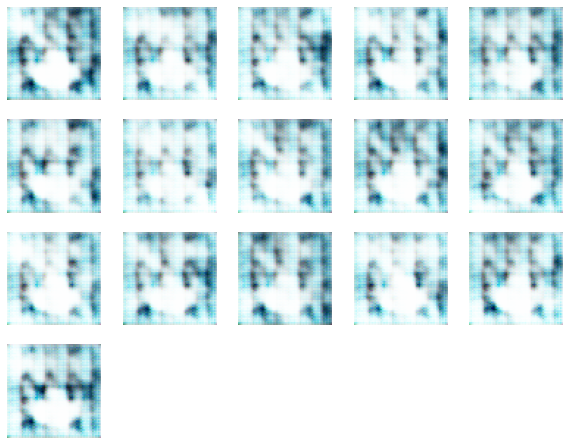

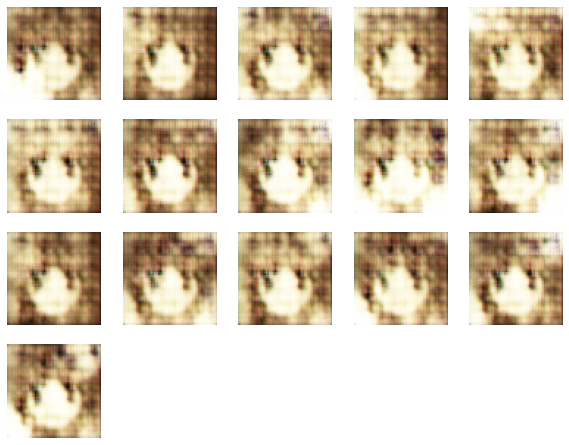

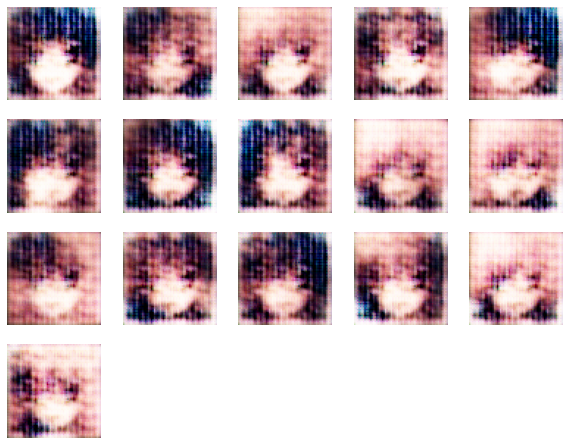

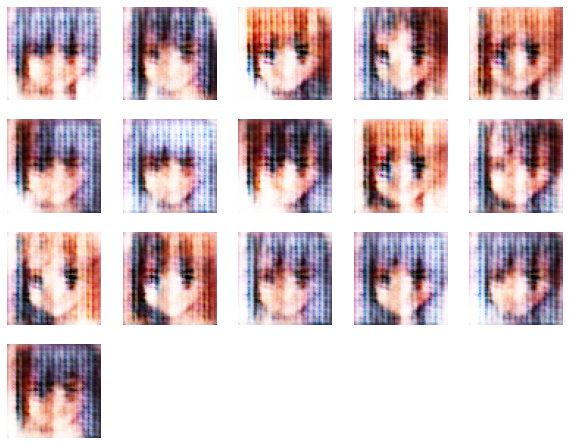

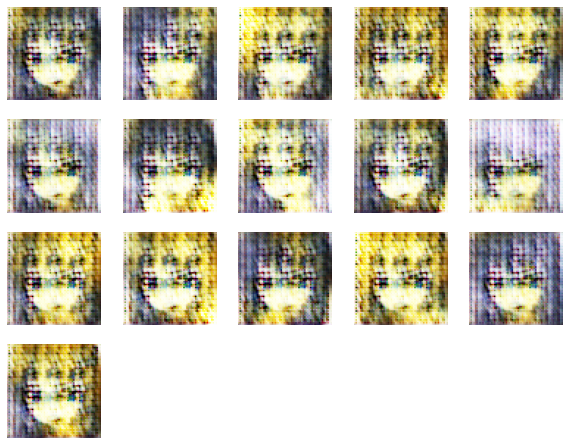

...

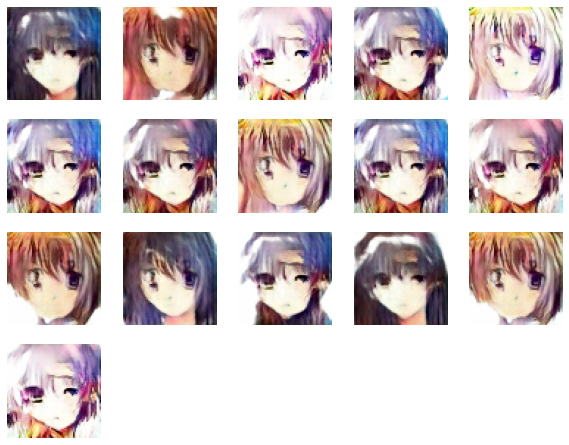

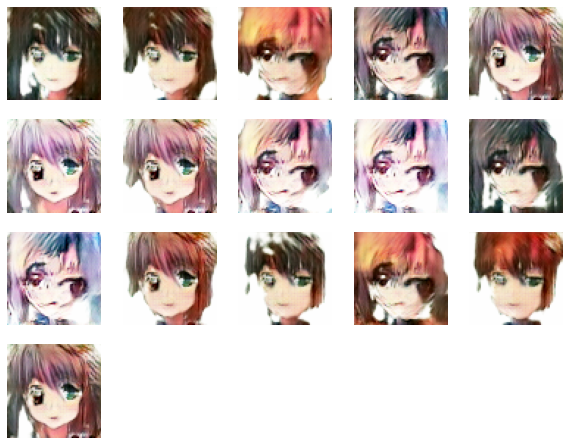

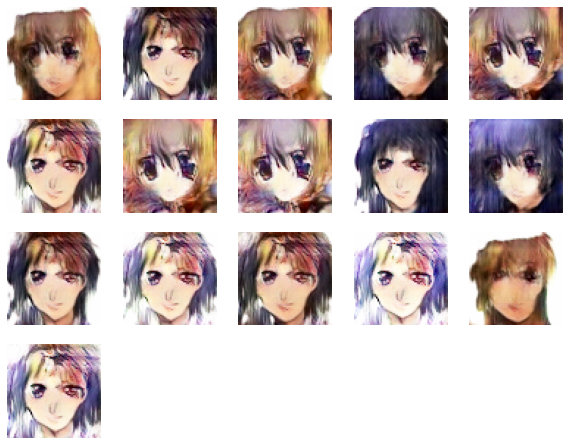

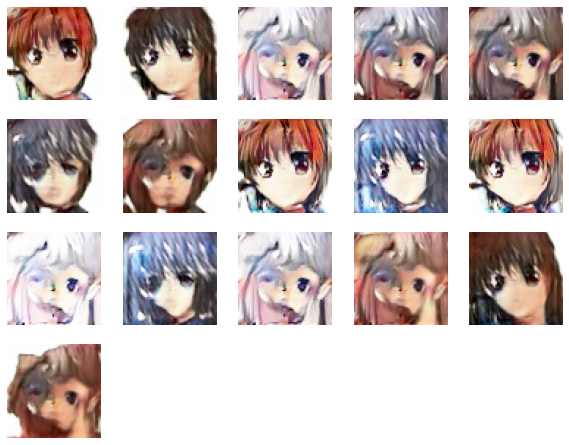

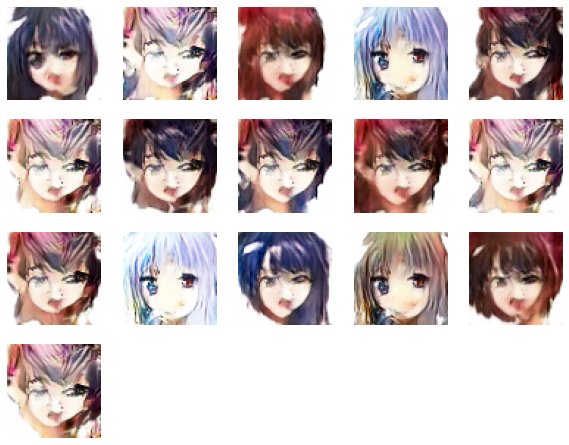

In [ ]:
import math

# Configs
max_epoch = 100
batch_size = 128

half_batch = int(batch_size/2)

# Train GAN
for epoch in tqdm(range(max_epoch)):

    for i in range(math.ceil(len(trainset) / half_batch)):

        # Update discriminator by real samples
        r_images = trainset[i*half_batch:(i+1)*half_batch]
        d_loss_r, _ = D.train_on_batch(r_images, np.ones((len(r_images), 1)))

        # Update discriminator by fake samples
        f_images = G.predict(np.random.normal(0, 1, (half_batch, 100))) # generate fake images
        d_loss_f, _ = D.train_on_batch(f_images, np.zeros((len(f_images), 1)))

        d_loss = (d_loss_r + d_loss_f)/2

        # Update generator
        g_loss = GAN.train_on_batch(np.random.normal(0, 1, (batch_size, 100)), np.ones((batch_size, 1)))

        # Print training progress
        print(f'[Epoch {epoch+1}, {min((i+1)*half_batch, len(trainset))}/{len(trainset)}] D_loss: {d_loss:0.4f}, G_loss: {g_loss:0.4f}')

    # Print validation result
    # evaluate discriminator on real examples
    _, acc_real = D.evaluate(trainset, np.ones((len(trainset), 1)), verbose=0)

    # evaluate discriminator on fake examples
    f_images = G.predict(np.random.normal(0, 1, (len(trainset), 100)))
    _, acc_fake = D.evaluate(f_images, np.zeros((len(trainset), 1)), verbose=0)

    # summarize discriminator performance
    print(f'[Epoch {epoch}] Accuracy real: {acc_real*100}, fake: {acc_fake*100}')

    # show generate results
    plt.figure(figsize=(10, 10))
    for i in range(16):
      ax = plt.subplot(5, 5, i + 1)
      plt.imshow(f_images[i])
      plt.axis("off")

# Step 6: Save model

In [ ]:
# save model
from tensorflow.keras.models import save_model
from google.colab import files

save_model(G, 'g.h5')
files.download('g.h5')

# for resume training
D.trainable = True
save_model(D, 'd.h5')
files.download('d.h5')

D.trainable = False
save_model(GAN, 'gan.h5')
files.download('gan.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Step 7: Load model and generate new images

In [2]:
# load model
from tensorflow.keras.models import load_model

G = load_model('g.h5')

new_images = G.predict(np.random.normal(0, 1, (16, 100)))
plot_images(new_images)